___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

# WELCOME!

## Introduction
Welcome to "***AutoScout Data Analysis Project***". This is the capstone project of ***Data Analysis*** Module. **Auto Scout** data which using for this project, scraped from the on-line car trading company in 2019, contains many features of 9 different car models. In this project, you will have the opportunity to apply many commonly used algorithms for Data Cleaning and Exploratory Data Analysis by using many Python libraries such as Numpy, Pandas, Matplotlib, Seaborn, Scipy you will analyze clean dataset.

The project consists of 3 parts:
* First part is related with 'data cleaning'. It deals with Incorrect Headers, Incorrect Format, Anomalies, Dropping useless columns.
* Second part is related with 'filling data'. It deals with Missing Values. Categorical to numeric transformation is done.
* Third part is related with 'handling outliers of data' via Visualisation libraries. Some insights are extracted.


In [ ]:
#pip install xlrd
#df4 = pd.read_excel("ScoutCarV3.xls")
#df1["Model Code"]
#df1["Model Code"] = df4["ModelCode"]
#df1["Model Code"]

# PART- 1 `( Data Cleaning )`

In [1056]:
# Libraries
import numpy as np
import pandas as pd
from scipy import misc
import scipy
import json

# Display options
# pd.set_option('display.max_rows', 3000)
# pd.set_option('display.max_columns', 500)
# pd.set_option('display.max_info_rows', 3000)
# pd.set_option('display.max_info_columns', 500)
# pd.set_option('display.max_colwidth', 500)
# pd.set_option('display.expand_frame_repr', True)
# pd.set_option('display.width', 3000)

# # Visualisation
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from collections import Counter
import warnings
warnings.filterwarnings('ignore') 

# # SQL
# import pyodbc
# import pandas.io.sql

# # Datetime
from datetime import datetime
now = datetime.now() # current date and time

In [1085]:
df = pd.read_json("scout_car.json",lines=True,orient='columns')
df1 = df.copy()

In [1086]:
df4 = pd.read_excel("ScoutCarV4ModelCode.xls")
df4.head(1)

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero


,ID,Model_Code
0,0,0588/BDF


In [1087]:
df1["Model Code"] = df4["Model_Code"]

In [1062]:
df1.head(1)

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
0,https://www.autoscout24.com//offers/audi-a1-sp...,Audi A1,Sportback 1.4 TDI S-tronic Xenon Navi Klima,Sedans,15770,VAT deductible,"56,013 km",01/2016,2 previous owners,NaN,...,"[\n, Sicherheit:, , Deaktivierung für Beifahr...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [340]:
df1.tail(1)

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
15918,https://www.autoscout24.com//offers/renault-es...,Renault Espace,INITIALE PARIS TCe 225 EDC GPF NAVI SHZ AUX,Van,40999,VAT deductible,- km,01/2019,1 previous owner,NaN,...,"[\n, Sicherheit Airbags:, , Seitenairbag, , ...",[\n4 (Green)\n],NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN


In [341]:
df1.sample(5)

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
12152,https://www.autoscout24.com//offers/opel-insig...,Opel Insignia,B Sports Tourer Innovation NAVI RF 900,Station wagon,20990,VAT deductible,"29,023 km",04/2018,1 previous owner,NaN,...,"[\n, Sonderausstattung:, Ergonomiesitz vorn re...",[\n4 (Green)\n],NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN
6951,https://www.autoscout24.com//offers/opel-astra...,Opel Astra,Sports Tourer Astra ST Edition 1.6 CDTI ecoFle...,Station wagon,11890,VAT deductible,"65,666 km",03/2017,1 previous owner,NaN,...,"[\nKlimaautomatik 2-Zonen, Klimaautomatik, Aud...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3842,https://www.autoscout24.com//offers/audi-a3-li...,Audi A3,"Limousine 1,6 TDI S tronic XENON NAVI",Sedans,21450,VAT deductible,"22,306 km",12/2017,1 previous owner,NaN,...,"[\n, Technik & Sicherheit:, Getriebe 7-Gang - ...",NaN,NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN
10443,https://www.autoscout24.com//offers/opel-corsa...,Opel Corsa,1.4 90 PS Selection-Klima-Radio-TOP AKTION SOF...,Sedans,10990,VAT deductible,250 km,-/-,None,NaN,...,[\n'Top-Endpreis incl. Überführungskosten frei...,[\n4 (Green)\n],[\n5\n],[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN
7351,https://www.autoscout24.com//offers/opel-astra...,Opel Astra,K 1.4 Turbo Dynamic/Navi/AGR/Frontkamera,Sedans,15100,VAT deductible,"29,486 km",02/2018,1 previous owner,NaN,...,"[\n, Fahrzeug steht in 14913 Jüterbog, Dennewi...",NaN,NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN


In [342]:
df1.columns

Index(['url', 'make_model', 'short_description', 'body_type', 'price', 'vat',
       'km', 'registration', 'prev_owner', 'kW', 'hp', 'Type',
       'Previous Owners', 'Next Inspection', 'Inspection new', 'Warranty',
       'Full Service', 'Non-smoking Vehicle', 'null', 'Make', 'Model',
       'Offer Number', 'First Registration', 'Body Color', 'Paint Type',
       'Body Color Original', 'Upholstery', 'Body', 'Nr. of Doors',
       'Nr. of Seats', 'Model Code', 'Gearing Type', 'Displacement',
       'Cylinders', 'Weight', 'Drive chain', 'Fuel', 'Consumption',
       'CO2 Emission', 'Emission Class', '\nComfort & Convenience\n',
       '\nEntertainment & Media\n', '\nExtras\n', '\nSafety & Security\n',
       'description', 'Emission Label', 'Gears', 'Country version',
       'Electricity consumption', 'Last Service Date', 'Other Fuel Types',
       'Availability', 'Last Timing Belt Service Date', 'Available from'],
      dtype='object')

In [343]:
df1.shape

(15919, 54)

In [344]:
df1.size

859626

In [345]:
df1.describe()

,price,kW
count,15919.000000,0.0
mean,18019.896727,NaN
std,7386.169409,NaN
min,13.000000,NaN
25%,12850.000000,NaN
50%,16900.000000,NaN
75%,21900.000000,NaN
max,74600.000000,NaN


In [346]:
df1.describe(include = object).T

,count,unique,top,freq
url,15919,15919,https://www.autoscout24.com//offers/renault-es...,1
make_model,15919,9,Audi A3,3097
short_description,15873,10001,SPB 1.6 TDI 116 CV S tronic Sport,64
body_type,15859,9,Sedans,7903
vat,11406,2,VAT deductible,10980
km,15919,6690,10 km,1045
registration,15919,48,-/-,1597
prev_owner,9091,4,1 previous owner,8294
hp,15919,81,85 kW,2542
Type,15917,169,"[, Used, , Diesel (Particulate Filter)]",3475


In [347]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15919 entries, 0 to 15918
Data columns (total 54 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   url                            15919 non-null  object 
 1   make_model                     15919 non-null  object 
 2   short_description              15873 non-null  object 
 3   body_type                      15859 non-null  object 
 4   price                          15919 non-null  int64  
 5   vat                            11406 non-null  object 
 6   km                             15919 non-null  object 
 7   registration                   15919 non-null  object 
 8   prev_owner                     9091 non-null   object 
 9   kW                             0 non-null      float64
 10  hp                             15919 non-null  object 
 11  Type                           15917 non-null  object 
 12  Previous Owners                9279 non-null  

In [348]:
dtypes = pd.DataFrame(df1.dtypes, columns = ['dtypes'])
dtypes

,dtypes
url,object
make_model,object
short_description,object
body_type,object
price,int64
vat,object
km,object
registration,object
prev_owner,object
kW,float64


In [349]:
notnull = pd.DataFrame(df1.notnull().sum(), columns = ['notnull'])
notnull

,notnull
url,15919
make_model,15919
short_description,15873
body_type,15859
price,15919
vat,11406
km,15919
registration,15919
prev_owner,9091
kW,0


In [350]:
isnull = pd.DataFrame(df1.isnull().sum(), columns = ['isnull'])
isnull

,isnull
url,0
make_model,0
short_description,46
body_type,60
price,0
vat,4513
km,0
registration,0
prev_owner,6828
kW,15919


In [351]:
for column in df1.columns:
    percentage = df1[column].isnull().mean()
    print(f'{column}:{round(percentage*100, 2)}%')

url:0.0%
make_model:0.0%
short_description:0.29%
body_type:0.38%
price:0.0%
vat:28.35%
km:0.0%
registration:0.0%
prev_owner:42.89%
kW:100.0%
hp:0.0%
Type:0.01%
Previous Owners:41.71%
Next Inspection:77.79%
Inspection new:75.3%
Warranty:34.05%
Full Service:48.39%
Non-smoking Vehicle:54.92%
null:0.0%
Make:0.0%
Model:0.0%
Offer Number:19.94%
First Registration:10.03%
Body Color:3.75%
Paint Type:36.26%
Body Color Original:23.61%
Upholstery:23.37%
Body:0.38%
Nr. of Doors:1.33%
Nr. of Seats:6.14%
Model Code:68.73%
Gearing Type:0.0%
Displacement:3.12%
Cylinders:35.68%
Weight:43.81%
Drive chain:43.08%
Fuel:0.0%
Consumption:11.97%
CO2 Emission:11.36%
Emission Class:18.98%

Comfort & Convenience
:5.78%

Entertainment & Media
:8.63%

Extras
:18.61%

Safety & Security
:6.17%
description:0.0%
Emission Label:74.97%
Gears:29.6%
Country version:52.35%
Electricity consumption:99.14%
Last Service Date:96.44%
Other Fuel Types:94.47%
Availability:96.01%
Last Timing Belt Service Date:99.9%
Available from:9

In [352]:
df1_summary = pd.concat([dtypes, notnull, isnull], axis = 1).reset_index().rename({'index':'Columns'},axis = 1)
df1_summary

,Columns,dtypes,notnull,isnull
0,url,object,15919,0
1,make_model,object,15919,0
2,short_description,object,15873,46
3,body_type,object,15859,60
4,price,int64,15919,0
5,vat,object,11406,4513
6,km,object,15919,0
7,registration,object,15919,0
8,prev_owner,object,9091,6828
9,kW,float64,0,15919


# COLUMN-0 url (DROP)

Since the information in each row of this column is included by other columns there is no need to keep it for further analysis.

In [353]:
df1['url'].head(5)

0    https://www.autoscout24.com//offers/audi-a1-sp...
1    https://www.autoscout24.com//offers/audi-a1-1-...
2    https://www.autoscout24.com//offers/audi-a1-sp...
3    https://www.autoscout24.com//offers/audi-a1-1-...
4    https://www.autoscout24.com//offers/audi-a1-sp...
Name: url, dtype: object

In [354]:
df1['url'][0]

'https://www.autoscout24.com//offers/audi-a1-sportback-1-4-tdi-s-tronic-xenon-navi-klima-diesel-black-bdab349a-caa5-41b0-98eb-c1345b84445e'

In [355]:
df1['url'].unique()

array(['https://www.autoscout24.com//offers/audi-a1-sportback-1-4-tdi-s-tronic-xenon-navi-klima-diesel-black-bdab349a-caa5-41b0-98eb-c1345b84445e',
       'https://www.autoscout24.com//offers/audi-a1-1-8-tfsi-sport-gasoline-red-b2547f8a-e83f-6237-e053-e250040a56df',
       'https://www.autoscout24.com//offers/audi-a1-sportback-1-6-tdi-s-tronic-einparkhilfe-plus-music-diesel-black-6183cb6a-8570-4b86-a132-9b54214bca88',
       ...,
       'https://www.autoscout24.com//offers/renault-espace-blue-dci-200-edc-initiale-paris-leder-led-navi-key-diesel-white-6256d1a3-ea68-4193-91de-b5b5ffa4631c',
       'https://www.autoscout24.com//offers/renault-espace-blue-dci-200cv-edc-business-nuova-da-immatricola-diesel-grey-5b0251a1-bd88-475c-a039-7e499da85d9d',
       'https://www.autoscout24.com//offers/renault-espace-initiale-paris-tce-225-edc-gpf-navi-shz-aux-gasoline-grey-0bd690d9-7e93-4cab-bc5a-9d5b63402481'],
      dtype=object)

In [356]:
df1['url'].nunique()

15919

# COLUMN-1 make_model (KEEP)

Although this column (make_model) seems clear; nevertheless, we will make a decision in accordaance with the columns of 19 "Make" and 20 "Model". Probably we will decide to maintain these 3 columns in case we need "Make" and "Model" seperately for further analysis. 

In [357]:
# (1) make_model, (19) Make ve (20) Model sütunları içerikleri örtüştüğünden bu 3 sütunu beraber inceleyeceğiz.

In [358]:
df1.make_model.unique()

array(['Audi A1', 'Audi A2', 'Audi A3', 'Opel Astra', 'Opel Corsa',
       'Opel Insignia', 'Renault Clio', 'Renault Duster',
       'Renault Espace'], dtype=object)

In [359]:
df1.make_model.nunique()

9

In [360]:
df1.make_model.value_counts(dropna=False)

Audi A3           3097
Audi A1           2614
Opel Insignia     2598
Opel Astra        2526
Opel Corsa        2219
Renault Clio      1839
Renault Espace     991
Renault Duster      34
Audi A2              1
Name: make_model, dtype: int64

In [361]:
df1[df1['make_model']=='Audi A2']

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
2614,https://www.autoscout24.com//offers/audi-a2-30...,Audi A2,"30 TDI Navi, Lane assist, Sitzheizung, Einpark...",Off-Road,28200,VAT deductible,"26,166 km",10/2018,1 previous owner,NaN,...,"[\n, Technik & Sicherheit:, 7-Gang-Automatikge...",[\n4 (Green)\n],NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN


In [362]:
df1[df1['make_model'].isin(['Audi A2'])]

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
2614,https://www.autoscout24.com//offers/audi-a2-30...,Audi A2,"30 TDI Navi, Lane assist, Sitzheizung, Einpark...",Off-Road,28200,VAT deductible,"26,166 km",10/2018,1 previous owner,NaN,...,"[\n, Technik & Sicherheit:, 7-Gang-Automatikge...",[\n4 (Green)\n],NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN


In [363]:
df1[df1['body_type']=='Off-Road']

,url,make_model,short_description,body_type,price,vat,km,registration,prev_owner,kW,...,description,Emission Label,Gears,Country version,Electricity consumption,Last Service Date,Other Fuel Types,Availability,Last Timing Belt Service Date,Available from
2614,https://www.autoscout24.com//offers/audi-a2-30...,Audi A2,"30 TDI Navi, Lane assist, Sitzheizung, Einpark...",Off-Road,28200,VAT deductible,"26,166 km",10/2018,1 previous owner,NaN,...,"[\n, Technik & Sicherheit:, 7-Gang-Automatikge...",[\n4 (Green)\n],NaN,[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN
7106,https://www.autoscout24.com//offers/opel-astra...,Opel Astra,K ST INNO Matrix IntelliLink Lenk/SHZ T-Leder ...,Off-Road,18590,VAT deductible,"12,607 km",06/2018,1 previous owner,NaN,...,"[\nFahrtauglich, 4 Einstiegstüren, Herstellerg...",[\n4 (Green)\n],[\n6\n],NaN,NaN,NaN,NaN,NaN,NaN,NaN
8954,https://www.autoscout24.com//offers/opel-corsa...,Opel Corsa,SELECTIVE 1.4 GASOLINA 90CV,Off-Road,7900,None,"35,410 km",04/2017,None,NaN,...,"[\n¡¡TOTALMENTE EQUIPADO!!, Sistema antibloque...",NaN,[\n5\n],NaN,NaN,NaN,NaN,NaN,NaN,NaN
8956,https://www.autoscout24.com//offers/opel-corsa...,Opel Corsa,SELECTIVE 1.4 GASOLINA 90CV 5P,Off-Road,7900,None,"37,634 km",04/2017,None,NaN,...,"[\n¡¡TOTALMENTE EQUIPADO!!, Sistema antibloque...",NaN,[\n5\n],NaN,NaN,NaN,NaN,NaN,NaN,NaN
9148,https://www.autoscout24.com//offers/opel-corsa...,Opel Corsa,COLOR EDITION 1.4 TURBO 100CV S/S 5P,Off-Road,8700,None,"79,143 km",03/2017,None,NaN,...,"[\n¡¡TOTALMENTE EQUIPADO!!, Asiento trasero di...",NaN,[\n6\n],NaN,NaN,NaN,NaN,NaN,NaN,NaN
10818,https://www.autoscout24.com//offers/opel-insig...,Opel Insignia,2.0 CDTi 170cv COUNTRY TOURER // 4WD // AUTOM //,Off-Road,12750,VAT deductible,"159,000 km",05/2016,1 previous owner,NaN,...,"[\n, ETAT IMPECCABLE ! *** , 1ER PROPRIETAIRE ...",NaN,NaN,[\nBelgium\n],NaN,NaN,NaN,NaN,NaN,NaN
12545,https://www.autoscout24.com//offers/opel-insig...,Opel Insignia,Country Tourer 2.0CDTI S&S Aut. 4x4 210,Off-Road,34776,None,- km,-/-,None,NaN,...,[],NaN,[\n8\n],NaN,NaN,NaN,NaN,NaN,NaN,NaN
12629,https://www.autoscout24.com//offers/opel-insig...,Opel Insignia,Country Tourer 1.6 T SHT S&S Aut. 4x4 200,Off-Road,32345,None,- km,-/-,None,NaN,...,[],NaN,[\n6\n],NaN,NaN,NaN,NaN,NaN,NaN,NaN
12647,https://www.autoscout24.com//offers/opel-insig...,Opel Insignia,Country Tourer 2.0CDTI S&S Aut. 170,Off-Road,31505,None,- km,-/-,None,NaN,...,[],NaN,[\n8\n],NaN,NaN,NaN,NaN,NaN,NaN,NaN
12809,https://www.autoscout24.com//offers/opel-insig...,Opel Insignia,Sports Tourer INNOVATION 1.5 DIRECT INJEC 121 ...,Off-Road,33490,VAT deductible,8 km,-/-,None,NaN,...,"[\n- 180-Grad-Panorama-Ruckfahrkame, - Park & ...",[\n4 (Green)\n],[\n6\n],[\nGermany\n],NaN,NaN,NaN,NaN,NaN,NaN


In [364]:
df1.make_model.isnull().sum()

0

In [365]:
# () Make sütunu incelemesi
df.Make

0           \nAudi\n
1           \nAudi\n
2           \nAudi\n
3           \nAudi\n
4           \nAudi\n
5           \nAudi\n
6           \nAudi\n
7           \nAudi\n
8           \nAudi\n
9           \nAudi\n
10          \nAudi\n
11          \nAudi\n
12          \nAudi\n
13          \nAudi\n
14          \nAudi\n
15          \nAudi\n
16          \nAudi\n
17          \nAudi\n
18          \nAudi\n
19          \nAudi\n
20          \nAudi\n
21          \nAudi\n
22          \nAudi\n
23          \nAudi\n
24          \nAudi\n
25          \nAudi\n
26          \nAudi\n
27          \nAudi\n
28          \nAudi\n
29          \nAudi\n
30          \nAudi\n
31          \nAudi\n
32          \nAudi\n
33          \nAudi\n
34          \nAudi\n
35          \nAudi\n
36          \nAudi\n
37          \nAudi\n
38          \nAudi\n
39          \nAudi\n
40          \nAudi\n
41          \nAudi\n
42          \nAudi\n
43          \nAudi\n
44          \nAudi\n
45          \nAudi\n
46          \nAudi\n
47          \

In [366]:
df1['Make'] = df1['Make'].map(lambda x : x.strip('\n '), na_action = 'ignore')
df1['Make']

0           Audi
1           Audi
2           Audi
3           Audi
4           Audi
5           Audi
6           Audi
7           Audi
8           Audi
9           Audi
10          Audi
11          Audi
12          Audi
13          Audi
14          Audi
15          Audi
16          Audi
17          Audi
18          Audi
19          Audi
20          Audi
21          Audi
22          Audi
23          Audi
24          Audi
25          Audi
26          Audi
27          Audi
28          Audi
29          Audi
30          Audi
31          Audi
32          Audi
33          Audi
34          Audi
35          Audi
36          Audi
37          Audi
38          Audi
39          Audi
40          Audi
41          Audi
42          Audi
43          Audi
44          Audi
45          Audi
46          Audi
47          Audi
48          Audi
49          Audi
50          Audi
51          Audi
52          Audi
53          Audi
54          Audi
55          Audi
56          Audi
57          Audi
58          Au

In [367]:
df1['Make'].value_counts(dropna=False)

Opel       7343
Audi       5712
Renault    2864
Name: Make, dtype: int64

In [368]:
df1['Make'].isnull().sum()

0

In [369]:
# () Model sütunu incelemesi
df1.Model

0              [\n, A1, \n]
1              [\n, A1, \n]
2              [\n, A1, \n]
3              [\n, A1, \n]
4              [\n, A1, \n]
5              [\n, A1, \n]
6              [\n, A1, \n]
7              [\n, A1, \n]
8              [\n, A1, \n]
9              [\n, A1, \n]
10             [\n, A1, \n]
11             [\n, A1, \n]
12             [\n, A1, \n]
13             [\n, A1, \n]
14             [\n, A1, \n]
15             [\n, A1, \n]
16             [\n, A1, \n]
17             [\n, A1, \n]
18             [\n, A1, \n]
19             [\n, A1, \n]
20             [\n, A1, \n]
21             [\n, A1, \n]
22             [\n, A1, \n]
23             [\n, A1, \n]
24             [\n, A1, \n]
25             [\n, A1, \n]
26             [\n, A1, \n]
27             [\n, A1, \n]
28             [\n, A1, \n]
29             [\n, A1, \n]
30             [\n, A1, \n]
31             [\n, A1, \n]
32             [\n, A1, \n]
33             [\n, A1, \n]
34             [\n, A1, \n]
35             [\n, 

In [370]:
df1['Model'] = df1['Model'].map(lambda x : x[1], na_action = 'ignore')
df1['Model'] 

0              A1
1              A1
2              A1
3              A1
4              A1
5              A1
6              A1
7              A1
8              A1
9              A1
10             A1
11             A1
12             A1
13             A1
14             A1
15             A1
16             A1
17             A1
18             A1
19             A1
20             A1
21             A1
22             A1
23             A1
24             A1
25             A1
26             A1
27             A1
28             A1
29             A1
30             A1
31             A1
32             A1
33             A1
34             A1
35             A1
36             A1
37             A1
38             A1
39             A1
40             A1
41             A1
42             A1
43             A1
44             A1
45             A1
46             A1
47             A1
48             A1
49             A1
50             A1
51             A1
52             A1
53             A1
54             A1
55        

In [371]:
df1['Model'].value_counts(dropna=False)

A3          3097
A1          2614
Insignia    2598
Astra       2526
Corsa       2219
Clio        1839
Espace       991
Duster        34
A2             1
Name: Model, dtype: int64

In [372]:
df1['Model'].isnull().sum()

0

In [373]:
df1[['make_model', 'Make', 'Model']].sample(20)

,make_model,Make,Model
4390,Audi A3,Audi,A3
12903,Opel Insignia,Opel,Insignia
13357,Renault Clio,Renault,Clio
12631,Opel Insignia,Opel,Insignia
8957,Opel Corsa,Opel,Corsa
7020,Opel Astra,Opel,Astra
13887,Renault Clio,Renault,Clio
7517,Opel Astra,Opel,Astra
12745,Opel Insignia,Opel,Insignia
14632,Renault Clio,Renault,Clio


In [374]:
df[['make_model', 'Make', 'Model']].isnull().sum()

make_model    0
Make          0
Model         0
dtype: int64

In [375]:
pd.get_dummies(df1.make_model).sample(20)

,Audi A1,Audi A2,Audi A3,Opel Astra,Opel Corsa,Opel Insignia,Renault Clio,Renault Duster,Renault Espace
2626,0,0,1,0,0,0,0,0,0
1022,1,0,0,0,0,0,0,0,0
15896,0,0,0,0,0,0,0,0,1
13907,0,0,0,0,0,0,1,0,0
10519,0,0,0,0,0,1,0,0,0
7868,0,0,0,1,0,0,0,0,0
6889,0,0,0,1,0,0,0,0,0
10670,0,0,0,0,0,1,0,0,0
7610,0,0,0,1,0,0,0,0,0
11226,0,0,0,0,0,1,0,0,0


# COLUMN-2 short_description (DROP)

Since the information in each row of this column is included by other columns so there is no need to keep it for further analysis.

In [376]:
df.short_description

0              Sportback 1.4 TDI S-tronic Xenon Navi Klima
1                                           1.8 TFSI sport
2        Sportback 1.6 TDI S tronic Einparkhilfe plus+m...
3                                  1.4 TDi Design S tronic
4        Sportback 1.4 TDI S-Tronic S-Line Ext. admired...
5              1.6 TDI Sport DSG *SHZ*Xenon*Navi*Bose*PDC*
6            Sportback 1.6 TDI S-TRONIC S-LINE*NAVI|XENON*
7                       Sportback 1.4 TDI admired S tronic
8                   SPB 1.6 TDI S-tronic Metal plus + Xeno
9                    SPORTBACK TFSI ULTRA 95 S-TRONIC AMB.
10             SPORTBACK1.6 TDI 116 CV S tronic Metal plus
11       Sportback Sport »1.4 TFSI|Xenon|Navi|EPH+|SHZ|...
12            Sportback 1.4 TFSI S-tronic *S line*NAV*XEN*
13             1.4 TFSI 150ch COD Ambition Luxe S tronic 7
14       Sportback 1.0 TFSI S-TRonic*Navi*Xenon*APS* Sport
15                       SPB 1.6 TDI 116 CV S tronic Sport
16       SPB 1.6 TDI 116 CV Design S-Line SPB 1.6 TDI 1.

In [377]:
df.short_description[0]

'Sportback 1.4 TDI S-tronic Xenon Navi Klima'

In [378]:
df.url[0]

'https://www.autoscout24.com//offers/audi-a1-sportback-1-4-tdi-s-tronic-xenon-navi-klima-diesel-black-bdab349a-caa5-41b0-98eb-c1345b84445e'

In [379]:
df.short_description.unique()

array(['Sportback 1.4 TDI S-tronic Xenon Navi Klima', '1.8 TFSI sport',
       'Sportback 1.6 TDI S tronic Einparkhilfe plus+music', ...,
       'ELYSEE ENERGY dCi 160 EDC',
       'INITIALE Paris TCe 225 EDC GPF ACC EU6',
       'TCe 225 EDC GPF LIM Deluxe Pano,RFK'], dtype=object)

In [380]:
df.short_description.nunique()

10001

In [381]:
df.short_description.value_counts(dropna=False)

SPB 1.6 TDI 116 CV S tronic Sport                     64
NaN                                                   46
1.4 66kW (90CV) Selective                             40
MOVE KLIMA CD USB ALLWETTER BLUETOOTH                 38
SPB 30 TFSI S tronic Admired                          35
SPB 30 TDI S tronic Business                          35
Sporter 1.5 dCi 90CV Zen , NAVI - AZIENDALE           32
dCi 75 Business Energy eco2 Euro6 55 kW (75 C         31
dCi 160CV EDC Energy Intens                           30
1.2 5 porte b-Color                                   30
R.S. TROPHY ENERGY TCe 220 EDC                        28
1.2 5 porte Advance                                   28
SPB 1.6 TDI 116 CV Sport                              28
1.4 TDI Design DKG*Navi*PDC*Alu*SHZ*                  27
1.6 TDI Sport DSG *SHZ*Xenon*Navi*Bose*PDC*           27
1.4 TFSI Design*PDC*Sport-S*LM-Felgen*SHZ*            27
1.4 TFSI Attraction (125 CV)                          27
1.6 TCE ENERGY INTENS *Navi*LED

In [382]:
df.short_description.isnull().sum()

46

# COLUMN-3 body_type (KEEP)

In [383]:
# (3) body_type ve (27) Body sütunlarını aynı bilgiyi içerdiğinden bu 2 sütunu beraber inceleyeceğiz.

In [384]:
df1['body_type'].unique()

array(['Sedans', 'Station wagon', 'Compact', 'Other', 'Coupe', 'Van',
       'Off-Road', 'Convertible', None, 'Transporter'], dtype=object)

In [385]:
df1.body_type.nunique()

9

In [386]:
df1.body_type.value_counts(dropna=False)

Sedans           7903
Station wagon    3553
Compact          3153
Van               783
Other             290
Transporter        88
NaN                60
Off-Road           56
Coupe              25
Convertible         8
Name: body_type, dtype: int64

In [387]:
df1.body_type.isnull().sum()

60

In [388]:
df1[['body_type', 'Body']].sample(20)

,body_type,Body
12533,Station wagon,"[\n, Station wagon, \n]"
737,Sedans,"[\n, Sedans, \n]"
9356,Compact,"[\n, Compact, \n]"
8380,Sedans,"[\n, Sedans, \n]"
14386,Sedans,"[\n, Sedans, \n]"
6626,Sedans,"[\n, Sedans, \n]"
2282,Compact,"[\n, Compact, \n]"
12801,Sedans,"[\n, Sedans, \n]"
10879,Other,"[\n, Other, \n]"
12500,Station wagon,"[\n, Station wagon, \n]"


In [389]:
df1[['body_type', 'Body']].isnull().sum()

body_type    60
Body         60
dtype: int64

In [390]:
df1['Body'] = df1['Body'].map(lambda x : x[1], na_action = 'ignore')
df1['Body']

0               Sedans
1               Sedans
2               Sedans
3               Sedans
4               Sedans
5               Sedans
6        Station wagon
7              Compact
8               Sedans
9               Sedans
10              Sedans
11              Sedans
12              Sedans
13              Sedans
14              Sedans
15              Sedans
16              Sedans
17              Sedans
18             Compact
19              Sedans
20              Sedans
21              Sedans
22              Sedans
23              Sedans
24              Sedans
25              Sedans
26             Compact
27              Sedans
28              Sedans
29             Compact
30             Compact
31              Sedans
32             Compact
33              Sedans
34              Sedans
35             Compact
36              Sedans
37              Sedans
38              Sedans
39             Compact
40             Compact
41             Compact
42             Compact
43         

In [391]:
df1['Body'].unique()

array(['Sedans', 'Station wagon', 'Compact', 'Other', 'Coupe', 'Van',
       'Off-Road', 'Convertible', nan, 'Transporter'], dtype=object)

In [392]:
df1['Body'].nunique()

9

In [393]:
df1['Body'].value_counts(dropna=False)

Sedans           7903
Station wagon    3553
Compact          3153
Van               783
Other             290
Transporter        88
NaN                60
Off-Road           56
Coupe              25
Convertible         8
Name: Body, dtype: int64

In [394]:
df1['Body'].isnull().sum()

60

# COLUMN-4 price (KEEP)

Target sütun

In [395]:
df1.price.unique()

array([15770, 14500, 14640, ..., 41390, 39885, 39875], dtype=int64)

In [396]:
df1.price.nunique()

2956

In [397]:
df1.price.value_counts(dropna=False)

14990    154
15990    151
10990    139
15900    106
17990    102
9900      98
20900     93
22900     92
13990     92
21900     91
19900     89
14900     88
16990     86
17900     86
18900     86
16900     84
18990     81
8490      78
12990     77
21500     75
19990     73
9990      70
18490     70
7900      70
13500     69
13900     68
9999      67
8990      67
16500     65
8500      65
20500     64
9500      61
15500     61
18500     61
8900      60
15450     60
12900     60
15490     59
14950     59
24900     59
14490     59
20990     58
10900     58
17500     57
22500     54
15980     54
15950     52
21490     51
11990     51
15850     50
23900     50
10450     50
23500     49
22990     49
12500     49
9800      47
7950      46
10500     44
10950     43
25490     42
17950     42
19500     42
18950     41
13950     41
16490     40
7800      39
12980     39
10490     39
26990     39
17490     38
21990     38
14980     38
11490     38
11500     37
17980     37
18000     36
15000     36

In [398]:
df1.price.isnull().sum()

0

In [399]:
df1[df1.price == 'nan'].value_counts().sum()

0

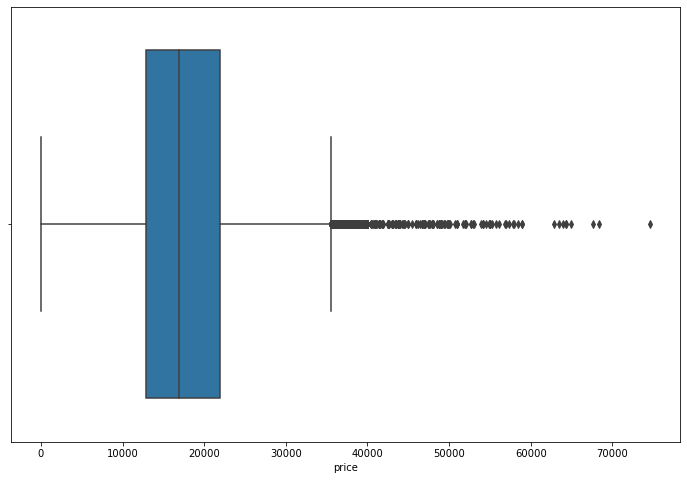

In [400]:
plt.figure(figsize=(12,8))

sns.boxplot(x = df1.price)

plt.show()

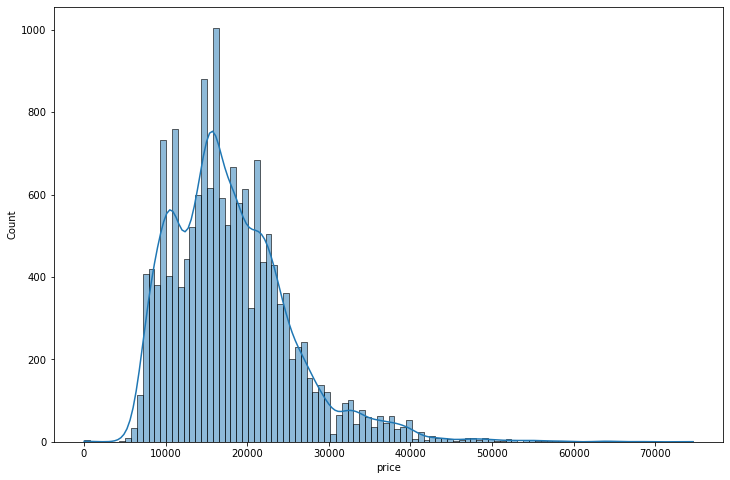

In [401]:
plt.figure(figsize=(12,8))

sns.histplot(x = df1.price, kde=True)

plt.show()

# COLUMN-5 vat (KEEP)

In [402]:
df1.vat.unique()

array(['VAT deductible', 'Price negotiable', None], dtype=object)

In [403]:
df1.vat.nunique()

2

In [404]:
df1.vat.value_counts(dropna=False)

VAT deductible      10980
NaN                  4513
Price negotiable      426
Name: vat, dtype: int64

In [405]:
df1.vat.isnull().sum()

4513

In [406]:
pd.get_dummies(df1.vat).head()

,Price negotiable,VAT deductible
0,0,1
1,1,0
2,0,1
3,0,0
4,0,0


# COLUMN-6 km (KEEP)

In [407]:
df1.km.unique()

array(['56,013 km', '80,000 km', '83,450 km', ..., '2,864 km', '1,506 km',
       '57 km'], dtype=object)

In [408]:
df1.km.nunique()

6690

In [409]:
df1.km.value_counts(dropna=False)

10 km         1045
- km          1024
1 km           367
5 km           170
50 km          148
100 km         139
15 km          109
5,000 km       104
20 km           61
3,000 km        58
12 km           56
8,000 km        49
45,000 km       48
30,000 km       47
25,000 km       47
10,000 km       47
1,000 km        46
18,000 km       46
19,000 km       44
35,000 km       44
15,000 km       43
70,000 km       43
150 km          43
6,000 km        41
40,000 km       40
20,000 km       40
7 km            38
9,000 km        38
80,000 km       37
50,000 km       36
11 km           35
500 km          35
17,000 km       34
16,000 km       34
55,000 km       34
11,000 km       33
3 km            33
28,000 km       32
60,000 km       32
24,000 km       31
29,000 km       31
8 km            31
2,500 km        31
100,000 km      31
89,000 km       30
22,000 km       30
26,000 km       29
47,000 km       29
3,500 km        29
3,898 km        28
21,379 km       28
10,564 km       27
39,000 km   

In [410]:
df1.km.isnull().sum()

0

In [411]:
df1[['km']]

,km
0,"56,013 km"
1,"80,000 km"
2,"83,450 km"
3,"73,000 km"
4,"16,200 km"
5,"63,668 km"
6,"62,111 km"
7,"14,986 km"
8,"57,000 km"
9,"16,103 km"


In [412]:
df1.km.str.replace(',', "")

0         56013 km
1         80000 km
2         83450 km
3         73000 km
4         16200 km
5         63668 km
6         62111 km
7         14986 km
8         57000 km
9         16103 km
10        11300 km
11        26415 km
12        31600 km
13        45764 km
14        34914 km
15        27000 km
16         9752 km
17        28408 km
18        50280 km
19        13406 km
20        51160 km
21        15850 km
22        17000 km
23         9077 km
24         3000 km
25       115000 km
26        84029 km
27        67800 km
28        14556 km
29        22000 km
30        38400 km
31        83307 km
32        39668 km
33        30353 km
34       126000 km
35        57500 km
36        73945 km
37        96000 km
38        43120 km
39       110715 km
40        31971 km
41        94800 km
42        85000 km
43       111265 km
44        44120 km
45        97976 km
46       106000 km
47        60000 km
48        58000 km
49        57454 km
50        94055 km
51        56000 km
52        27

In [413]:
df1['km'] = df1.km.str.replace(',','').str.strip(' km').replace('-', np.nan).astype(float)
# df1.km.str.replace(',', "").str.extract('(\d+)').astype(float).head()

In [414]:
df1['km']

0         56013.0
1         80000.0
2         83450.0
3         73000.0
4         16200.0
5         63668.0
6         62111.0
7         14986.0
8         57000.0
9         16103.0
10        11300.0
11        26415.0
12        31600.0
13        45764.0
14        34914.0
15        27000.0
16         9752.0
17        28408.0
18        50280.0
19        13406.0
20        51160.0
21        15850.0
22        17000.0
23         9077.0
24         3000.0
25       115000.0
26        84029.0
27        67800.0
28        14556.0
29        22000.0
30        38400.0
31        83307.0
32        39668.0
33        30353.0
34       126000.0
35        57500.0
36        73945.0
37        96000.0
38        43120.0
39       110715.0
40        31971.0
41        94800.0
42        85000.0
43       111265.0
44        44120.0
45        97976.0
46       106000.0
47        60000.0
48        58000.0
49        57454.0
50        94055.0
51        56000.0
52        27600.0
53       111670.0
54        30500.0
55        

In [415]:
df1['km'].value_counts(dropna=False)

10.0        1045
NaN         1024
1.0          367
5.0          170
50.0         148
100.0        139
15.0         109
5000.0       104
20.0          61
3000.0        58
12.0          56
8000.0        49
45000.0       48
25000.0       47
30000.0       47
10000.0       47
18000.0       46
1000.0        46
35000.0       44
19000.0       44
150.0         43
15000.0       43
70000.0       43
6000.0        41
20000.0       40
40000.0       40
7.0           38
9000.0        38
80000.0       37
50000.0       36
500.0         35
11.0          35
55000.0       34
16000.0       34
17000.0       34
3.0           33
11000.0       33
28000.0       32
60000.0       32
100000.0      31
29000.0       31
24000.0       31
2500.0        31
8.0           31
22000.0       30
89000.0       30
26000.0       29
3500.0        29
47000.0       29
3898.0        28
21379.0       28
31356.0       27
39000.0       27
42000.0       27
17768.0       27
49351.0       27
63668.0       27
49606.0       27
64000.0       

# COLUMN-7 registration (KEEP)

Age sütunu oluşturduğumuzdan farklı bir maksatla kullanılmayacağı değerlendirilirse DROP edilecek.

Age1 sütunu da DROP edilecek(First Registration)

In [416]:
# (8)registration & (22)First Registration sütunları içerikleri örtüştüğünden bu 2 sütunu beraber inceleyeceğiz.

In [417]:
df1[['registration', 'First Registration']].isnull().sum()

registration             0
First Registration    1597
dtype: int64

In [418]:
df1[['registration', 'First Registration']].sample(5)

,registration,First Registration
15429,11/2017,"[\n, 2017, \n]"
1867,06/2018,"[\n, 2018, \n]"
9418,04/2017,"[\n, 2017, \n]"
11754,02/2018,"[\n, 2018, \n]"
13705,05/2016,"[\n, 2016, \n]"


In [419]:
# 'registration' sütunu ile AGE hesaplaması

In [420]:
df1['registration'].map(lambda x: x[3:], na_action = 'ignore')

0        2016
1        2017
2        2016
3        2016
4        2016
5        2016
6        2016
7        2016
8        2016
9        2017
10       2018
11       2016
12       2016
13       2016
14       2016
15       2016
16       2018
17       2017
18       2016
19       2018
20       2017
21       2016
22       2016
23       2018
24       2018
25       2016
26       2016
27       2016
28       2018
29       2016
30       2016
31       2016
32       2016
33       2016
34       2016
35       2016
36       2016
37       2017
38       2016
39       2016
40       2016
41       2016
42       2016
43       2016
44       2016
45       2016
46       2016
47       2016
48       2016
49       2016
50       2016
51       2016
52       2016
53       2016
54       2016
55       2017
56       2016
57       2016
58       2016
59       2016
60       2016
61       2016
62       2016
63       2016
64       2016
65       2016
66       2017
67       2018
68       2017
69       2018
70       2017
71    

In [421]:
df1['registration'] = df1['registration'].map(lambda x: x[3:], na_action = 'ignore')

In [422]:
df1['registration'] = pd.to_numeric(df1['registration'],errors = 'coerce')

In [423]:
df1['age'] = 2019 - df1['registration']
df1['age']

0        3.0
1        2.0
2        3.0
3        3.0
4        3.0
5        3.0
6        3.0
7        3.0
8        3.0
9        2.0
10       1.0
11       3.0
12       3.0
13       3.0
14       3.0
15       3.0
16       1.0
17       2.0
18       3.0
19       1.0
20       2.0
21       3.0
22       3.0
23       1.0
24       1.0
25       3.0
26       3.0
27       3.0
28       1.0
29       3.0
30       3.0
31       3.0
32       3.0
33       3.0
34       3.0
35       3.0
36       3.0
37       2.0
38       3.0
39       3.0
40       3.0
41       3.0
42       3.0
43       3.0
44       3.0
45       3.0
46       3.0
47       3.0
48       3.0
49       3.0
50       3.0
51       3.0
52       3.0
53       3.0
54       3.0
55       2.0
56       3.0
57       3.0
58       3.0
59       3.0
60       3.0
61       3.0
62       3.0
63       3.0
64       3.0
65       3.0
66       2.0
67       1.0
68       2.0
69       1.0
70       2.0
71       2.0
72       2.0
73       1.0
74       1.0
75       3.0
76       1.0

# NEW COLUMN age

In [424]:
df1['age'].head(5)

0    3.0
1    2.0
2    3.0
3    3.0
4    3.0
Name: age, dtype: float64

In [425]:
df1['age'].value_counts(dropna=False)

1.0    4522
3.0    3674
2.0    3273
0.0    2853
NaN    1597
Name: age, dtype: int64

In [426]:
# age sütunundaki NULL değerlerin registration sütunundan kontrolü
df1[(df1['registration'].notnull()) & (df1['age'].isnull())].value_counts().sum()

0

In [427]:
# age sütunundaki NULL değerlerin First Registration sütunundan kontrolü
df1[(df1['First Registration'].notnull()) & (df1['age'].isnull())].value_counts().sum()

0

In [578]:
# age sütunundaki NULL değerlerin diğer sütunlar ile çapraz kontrolü
df1[(df1['age'].isnull())][['age', 'registration', 'prev_owner', 'Previous Owners', 'vehicle_condition']]

,age,registration,prev_owner,Previous Owners,vehicle_condition
743,NaN,NaN,0.0,0.0,New
869,NaN,NaN,0.0,0.0,New
946,NaN,NaN,NaN,NaN,New
977,NaN,NaN,NaN,NaN,New
980,NaN,NaN,0.0,0.0,New
1038,NaN,NaN,NaN,NaN,New
1064,NaN,NaN,NaN,NaN,New
1098,NaN,NaN,NaN,NaN,New
1125,NaN,NaN,NaN,NaN,New
1140,NaN,NaN,NaN,NaN,New


In [579]:
# age sütunundaki NULL değerler ve vehicle_condition New olanların diğer sütunlar ile çapraz kontrolü
df1[(df1['age'].isnull()) & (df1['vehicle_condition'] == 'New')][['age', 'registration', 'prev_owner', 'Previous Owners', 'vehicle_condition']]

,age,registration,prev_owner,Previous Owners,vehicle_condition
743,NaN,NaN,0.0,0.0,New
869,NaN,NaN,0.0,0.0,New
946,NaN,NaN,NaN,NaN,New
977,NaN,NaN,NaN,NaN,New
980,NaN,NaN,0.0,0.0,New
1038,NaN,NaN,NaN,NaN,New
1064,NaN,NaN,NaN,NaN,New
1098,NaN,NaN,NaN,NaN,New
1125,NaN,NaN,NaN,NaN,New
1140,NaN,NaN,NaN,NaN,New


In [580]:
# age sütunu NULL ve vehicle_condition New olan sütunların age değerlerinin 0.0 yapılması

df1.loc[(df1['age'].isnull()) & (df1['vehicle_condition'] == 'New'), 'age'] = 0

In [431]:
df1['age'].value_counts(dropna=False)

1.0    4522
3.0    3674
2.0    3273
0.0    2853
NaN    1597
Name: age, dtype: int64

In [581]:
# age sütunundaki NULL değerler ve vehicle_condition New olanların diğer sütunlar ile çapraz kontrolü
df1[(df1['age'].isnull())][['age', 'registration', 'prev_owner', 'Previous Owners', 'vehicle_condition', 'km', 'price', 'make_model']]

,age,registration,prev_owner,Previous Owners,vehicle_condition,km,price,make_model
5008,NaN,NaN,NaN,NaN,Pre-registered,10.0,26900,Audi A3
5260,NaN,NaN,NaN,NaN,Pre-registered,10.0,25390,Audi A3
5261,NaN,NaN,NaN,NaN,Pre-registered,10.0,25390,Audi A3
5329,NaN,NaN,NaN,NaN,Pre-registered,NaN,24900,Audi A3
5494,NaN,NaN,1.0,1.0,Pre-registered,10.0,23920,Audi A3


In [582]:
# age sütunu NULL ve vehicle_condition Demonstration olan sütunların age değerlerinin 0.0 yapılması

df1.loc[(df1['age'].isnull()) & (df1['vehicle_condition'] == 'Demonstration'), 'age'] = 0

In [583]:
df1['age'].value_counts(dropna=False)

1.0    4525
0.0    4326
3.0    3678
2.0    3385
NaN       5
Name: age, dtype: int64

In [584]:
# age sütunundaki NULL değerler ve vehicle_condition New olanların diğer sütunlar ile çapraz kontrolü
df1[(df1['age'].isnull())][['age', 'registration', 'prev_owner', 'Previous Owners', 'vehicle_condition', 'km', 'price', 'make_model']]

,age,registration,prev_owner,Previous Owners,vehicle_condition,km,price,make_model
5008,NaN,NaN,NaN,NaN,Pre-registered,10.0,26900,Audi A3
5260,NaN,NaN,NaN,NaN,Pre-registered,10.0,25390,Audi A3
5261,NaN,NaN,NaN,NaN,Pre-registered,10.0,25390,Audi A3
5329,NaN,NaN,NaN,NaN,Pre-registered,NaN,24900,Audi A3
5494,NaN,NaN,1.0,1.0,Pre-registered,10.0,23920,Audi A3


In [585]:
# age sütunu NULL ve vehicle_condition Pre-registered olan sütunların age değerlerinin 0.0 yapılması

df1.loc[(df1['age'].isnull()) & (df1['vehicle_condition'] == 'Pre-registered'), 'age'] = 0

In [586]:
df1['age'].value_counts(dropna=False)

1.0    4525
0.0    4331
3.0    3678
2.0    3385
Name: age, dtype: int64

In [587]:
# age sütunundaki NULL değerler ve vehicle_condition New olanların diğer sütunlar ile çapraz kontrolü
df1[(df1['age'].isnull())][['age', 'registration', 'prev_owner', 'Previous Owners', 'vehicle_condition', 'km', 'price', 'make_model']]

,age,registration,prev_owner,Previous Owners,vehicle_condition,km,price,make_model


In [439]:
# age sütunu NULL ve make_model i Audi A1 olan sütunların age değerlerinin km meanlerine göre girilmesi
# df1[(df1['make_model'] == 'Audi A1') & (df1['age'] == 0.0)]['km'].mean()
# age = 0 --> km.mean 2121.8536155202823, ['km'].max() 18000.0, ['km'].min() 0.0
# age = 1 --> km.mean 13785.85290148448, 47000.0, 1.0
# age = 2 --> km.mean 25821.712962962964, 148257, 10.0
# age = 3 --> km.mean 54332.28616852146, 192000.0, 3150.0

# > 7500 --> 0 (2100+13700)/2
# > 19000 --> 1 (13700+25800)/2
# > 40000 --> 2 (25800+54300)/2
# < 40000 --> 3 40000 DEN BÜYÜK

df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Audi A1') & (df1['km'] < 6000), 'age'] = 0

In [440]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Audi A1') & (df1['km'] < 19000), 'age'] = 1

In [441]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Audi A1') & (df1['km'] < 40000), 'age'] = 2

In [442]:
# age sütunu NULL ve make_model i Opel Astra olan sütunların age değerlerinin km meanlerine göre girilmesi

# > 11500 --> 0
# > 35000 --> 1
# > 69000 --> 2
# < 69000 --> 3

df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Astra') & (df1['km'] < 69000), 'age'] = 2

In [443]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Astra') & (df1['km'] > 69000), 'age'] = 3

In [444]:
# age sütunu NULL ve make_model i Opel Corsa olan sütunların age değerlerinin km meanlerine göre girilmesi

# > 9000 --> 0
# > 28500 --> 1
# > 51000 --> 2
# < 51000 --> 3

df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Corsa') & (df1['km'] < 9000 ), 'age'] = 0

In [445]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Corsa') & (df1['km'] < 28500 ), 'age'] = 1

In [446]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Corsa') & (df1['km'] < 51000 ), 'age'] = 2

In [447]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Corsa') & (df1['km'] > 51000 ), 'age'] = 3

In [448]:
# age sütunu NULL ve make_model i Opel Insignia olan sütunların age değerlerinin km meanlerine göre girilmesi

# > 12000 --> 0
# > 35000 --> 1
# > 70000 --> 2
# < 70000 --> 3

df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Insignia') & (df1['km'] < 12000 ), 'age'] = 0

In [449]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Insignia') & (df1['km'] < 35000 ), 'age'] = 1

In [450]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Insignia') & (df1['km'] < 70000 ), 'age'] = 2

In [451]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Insignia') & (df1['km'] > 70000 ), 'age'] = 3

In [452]:
# age sütunu NULL ve make_model i Renault Clio olan sütunların age değerlerinin km meanlerine göre girilmesi

# > 8000 --> 0
# > 26000 --> 1
# > 52500 --> 2
# < 52500 --> 3

df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Clio') & (df1['km'] < 8000 ), 'age'] = 0

In [453]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Clio') & (df1['km'] < 26000 ), 'age'] = 1

In [454]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Clio') & (df1['km'] < 52500 ), 'age'] = 2

In [455]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Clio') & (df1['km'] > 52500 ), 'age'] = 3

In [456]:
# age sütunu NULL ve make_model i Renault Espace olan sütunların age değerlerinin km meanlerine göre girilmesi

# > 7500 --> 0
# > 28000 --> 1
# > 58000 --> 2
# < 58000 --> 3

df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Espace') & (df1['km'] < 7500 ), 'age'] = 0

In [457]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Espace') & (df1['km'] < 28000 ), 'age'] = 1

In [458]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Espace') & (df1['km'] < 58000 ), 'age'] = 2

In [459]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Renault Espace') & (df1['km'] < 58000 ), 'age'] = 3

In [460]:
# make_model i Opel Insignia ve  price sütunu 33000 den büyük olan araçların age değerlerinin MEAN ine göre girilmesi

df1[(df1['make_model'] == 'Opel Insignia') & (df1['price'] > 33000)]['age'].mean()

0.0

In [461]:
df1.loc[(df1['age'].isnull()) & (df1['make_model'] == 'Opel Insignia'), 'age'] = 0

In [462]:
df1['age'].value_counts(dropna=False)

1.0    4525
3.0    3678
0.0    3523
2.0    3385
NaN     808
Name: age, dtype: int64

In [588]:
# age sütunundaki NULL değerler ve vehicle_condition New olanların diğer sütunlar ile çapraz kontrolü
df1[(df1['age'].isnull())][['age', 'registration', 'prev_owner', 'Previous Owners', 'vehicle_condition', 'km', 'price', 'make_model']]

,age,registration,prev_owner,Previous Owners,vehicle_condition,km,price,make_model


# COLUMN-8 prev_owner (KEEP)

In [464]:
# (9)prev_owner & (13)Previous Owners sütunları içerikleri örtüştüğünden bu 2 sütunu beraber inceleyeceğiz.

In [465]:
df1[['prev_owner', 'Previous Owners']].isnull().sum()

prev_owner         6828
Previous Owners    6640
dtype: int64

In [466]:
df1[['prev_owner', 'Previous Owners']].sample(5)

,prev_owner,Previous Owners
6553,1 previous owner,\n1\n
4923,None,NaN
11983,1 previous owner,\n1\n
4876,1 previous owner,\n1\n
13969,1 previous owner,\n1\n


In [467]:
# 'prev_owner' ile çalışma

In [468]:
df1['prev_owner'].str.strip('previous owners').astype(float)

0        2.0
1        NaN
2        1.0
3        1.0
4        1.0
5        1.0
6        1.0
7        1.0
8        1.0
9        NaN
10       NaN
11       1.0
12       1.0
13       NaN
14       1.0
15       1.0
16       NaN
17       1.0
18       NaN
19       NaN
20       1.0
21       1.0
22       1.0
23       NaN
24       1.0
25       NaN
26       1.0
27       1.0
28       NaN
29       NaN
30       NaN
31       1.0
32       1.0
33       1.0
34       NaN
35       1.0
36       1.0
37       1.0
38       2.0
39       1.0
40       1.0
41       1.0
42       1.0
43       1.0
44       1.0
45       1.0
46       1.0
47       NaN
48       2.0
49       1.0
50       1.0
51       1.0
52       NaN
53       NaN
54       1.0
55       1.0
56       1.0
57       1.0
58       2.0
59       NaN
60       1.0
61       1.0
62       1.0
63       1.0
64       1.0
65       NaN
66       NaN
67       NaN
68       1.0
69       1.0
70       NaN
71       1.0
72       1.0
73       1.0
74       1.0
75       1.0
76       1.0

In [469]:
df1.prev_owner = df1.prev_owner.str.strip('previous owners').astype(float)

In [470]:
df1.prev_owner.value_counts(dropna=False)

1.0    8294
NaN    6828
2.0     778
3.0      17
4.0       2
Name: prev_owner, dtype: int64

In [471]:
# 'Previous Owners' ile çalışma

In [472]:
df1['Previous Owners'].str.strip('\n').astype(float)

0        2.0
1        NaN
2        1.0
3        1.0
4        1.0
5        1.0
6        1.0
7        1.0
8        1.0
9        NaN
10       NaN
11       1.0
12       1.0
13       NaN
14       1.0
15       1.0
16       NaN
17       1.0
18       NaN
19       NaN
20       1.0
21       1.0
22       1.0
23       NaN
24       1.0
25       NaN
26       1.0
27       1.0
28       NaN
29       NaN
30       NaN
31       1.0
32       1.0
33       1.0
34       NaN
35       1.0
36       1.0
37       1.0
38       2.0
39       1.0
40       1.0
41       1.0
42       1.0
43       1.0
44       1.0
45       1.0
46       1.0
47       0.0
48       2.0
49       1.0
50       1.0
51       1.0
52       NaN
53       NaN
54       1.0
55       1.0
56       1.0
57       1.0
58       2.0
59       NaN
60       1.0
61       1.0
62       1.0
63       1.0
64       1.0
65       NaN
66       NaN
67       NaN
68       1.0
69       1.0
70       NaN
71       1.0
72       1.0
73       1.0
74       1.0
75       1.0
76       1.0

In [473]:
df1['Previous Owners'] = df1['Previous Owners'].str.strip('\n').astype(float)

In [474]:
df1['Previous Owners'].value_counts(dropna=False)

1.0    8101
NaN    6870
2.0     766
0.0     163
3.0      17
4.0       2
Name: Previous Owners, dtype: int64

In [475]:
# Her 2 sütunda yapılan işlemler sonucu NULL değer durumu

In [476]:
df1[['prev_owner', 'Previous Owners']].isnull().sum()

prev_owner         6828
Previous Owners    6870
dtype: int64

In [477]:
df1[['prev_owner', 'Previous Owners', 'age']].sample(20)

,prev_owner,Previous Owners,age
10886,1.0,1.0,3.0
10714,NaN,NaN,3.0
3560,1.0,1.0,3.0
6591,1.0,1.0,1.0
7250,1.0,1.0,1.0
2553,NaN,NaN,0.0
13167,1.0,1.0,2.0
15760,1.0,1.0,1.0
8437,1.0,1.0,1.0
7455,1.0,1.0,1.0


In [478]:
#'Previous Owners' sütununda 0 değerlerin age karşılıklarını kontrol et. 2019 yaş o ise new denebilir.

In [479]:
# 'prev_owner' sütununda ISNULL olup 'Previous Owners' sütununda NOTNULL alan kontrolü 

In [480]:
pd.set_option('display.max_rows', None)
df1[(df1['prev_owner'].isnull()) & (df1['Previous Owners'].notnull())][['prev_owner','Previous Owners']].value_counts().sum()

0

In [481]:
pd.set_option('display.max_rows', None)
df1[(df1['prev_owner'].notnull()) & (df1['Previous Owners'].isnull())][['prev_owner','Previous Owners']].value_counts().sum()

0

In [482]:
# Düzenleme yapılıp her 2 sütundaki prevowner sayıları alındıktan sonra null değerlere bakıldığında 'prev_owner' 
# sütununun kullanılması daha uygun. Daha az null değer var. 
# 'Previous Owners' sütunu başka bir yerde kullanılmayacaksa DROP edilebilir.

# 'Previous Owners' sütununda 163 adet 0 değer mevcut. NEW için kullanılabilir.

In [483]:
df1[['prev_owner', 'Previous Owners']].value_counts()

prev_owner  Previous Owners
1.0         1.0                8101
2.0         2.0                 766
3.0         3.0                  17
4.0         4.0                   2
dtype: int64

In [484]:
df1.prev_owner.value_counts(dropna=False)

1.0    8294
NaN    6828
2.0     778
3.0      17
4.0       2
Name: prev_owner, dtype: int64

In [485]:
df1['Previous Owners'].value_counts(dropna=False)

1.0    8101
NaN    6870
2.0     766
0.0     163
3.0      17
4.0       2
Name: Previous Owners, dtype: int64

In [486]:
df1[['prev_owner', 'Previous Owners']].isnull().sum()

prev_owner         6828
Previous Owners    6870
dtype: int64

In [487]:
df1[(df1['prev_owner'].notnull()) != (df1['Previous Owners'].notnull())][['prev_owner', 'Previous Owners']]

,prev_owner,Previous Owners
47,NaN,0.0
418,NaN,0.0
586,NaN,0.0
648,NaN,0.0
734,NaN,0.0
743,NaN,0.0
869,NaN,0.0
980,NaN,0.0
1080,1.0,NaN
1097,1.0,NaN


In [589]:
df1[(df1['Previous Owners']==0.0) ][['Previous Owners', 'age', 'registration', 'vehicle_condition']].sort_values(by='age')

,Previous Owners,age,registration,vehicle_condition
5580,0.0,0.0,NaN,New
5664,0.0,0.0,NaN,New
5668,0.0,0.0,NaN,New
5672,0.0,0.0,NaN,New
5689,0.0,0.0,NaN,New
5699,0.0,0.0,NaN,New
7486,0.0,0.0,NaN,New
5655,0.0,0.0,NaN,New
7489,0.0,0.0,NaN,New
9882,0.0,0.0,NaN,New


In [489]:
# 'Previous Owners' sütunundaki 0.0 değerleri 'prev_owner' sütununa geçirilecek ve  'Previous Owners'  DROP edilecek
# vehicle condition used olanlardan yapılabilirse prev__owner ı 0 olanlar 1 olacak
# prev owner 0 olanlardan age boş olanlar 0 girilecek.

In [490]:
df1['prev_owner'].value_counts(dropna=False)

1.0    8294
NaN    6828
2.0     778
3.0      17
4.0       2
Name: prev_owner, dtype: int64

In [491]:
df1[(df1['prev_owner'].isnull()) & (df1['Previous Owners'] == 0.0)][['prev_owner', 'Previous Owners']]

,prev_owner,Previous Owners
47,NaN,0.0
418,NaN,0.0
586,NaN,0.0
648,NaN,0.0
734,NaN,0.0
743,NaN,0.0
869,NaN,0.0
980,NaN,0.0
1099,NaN,0.0
1194,NaN,0.0


In [492]:
# prev_owner değerleri NULL, Previous Owners değerleri 0.0 olan prev_owner sütunlarının 0.0 ile doldurulması

df1.loc[(df1['prev_owner'].isnull()) & (df1['Previous Owners'] == 0.0), 'prev_owner'] = 0

In [493]:
df1['prev_owner'].value_counts(dropna=False)

1.0    8294
NaN    6665
2.0     778
0.0     163
3.0      17
4.0       2
Name: prev_owner, dtype: int64

# COLUMN-9 kW (DROP)

DROP edilecek

In [494]:
df1['kW']

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
5       NaN
6       NaN
7       NaN
8       NaN
9       NaN
10      NaN
11      NaN
12      NaN
13      NaN
14      NaN
15      NaN
16      NaN
17      NaN
18      NaN
19      NaN
20      NaN
21      NaN
22      NaN
23      NaN
24      NaN
25      NaN
26      NaN
27      NaN
28      NaN
29      NaN
30      NaN
31      NaN
32      NaN
33      NaN
34      NaN
35      NaN
36      NaN
37      NaN
38      NaN
39      NaN
40      NaN
41      NaN
42      NaN
43      NaN
44      NaN
45      NaN
46      NaN
47      NaN
48      NaN
49      NaN
50      NaN
51      NaN
52      NaN
53      NaN
54      NaN
55      NaN
56      NaN
57      NaN
58      NaN
59      NaN
60      NaN
61      NaN
62      NaN
63      NaN
64      NaN
65      NaN
66      NaN
67      NaN
68      NaN
69      NaN
70      NaN
71      NaN
72      NaN
73      NaN
74      NaN
75      NaN
76      NaN
77      NaN
78      NaN
79      NaN
80      NaN
81      NaN
82      NaN
83  

In [495]:
df1['kW'].isnull().sum()

15919

In [496]:
# 'kW' sütunu tamamiyle NULL olduğundan DROP edilecek.

# COLUMN-10 hp (KEEP)

In [497]:
df1['hp']

0         66 kW
1        141 kW
2         85 kW
3         66 kW
4         66 kW
5         85 kW
6         85 kW
7         66 kW
8         85 kW
9         70 kW
10        85 kW
11        92 kW
12        92 kW
13       112 kW
14        70 kW
15        85 kW
16        85 kW
17        66 kW
18        70 kW
19        85 kW
20        85 kW
21        92 kW
22        92 kW
23        85 kW
24        70 kW
25        70 kW
26        70 kW
27        70 kW
28        66 kW
29        70 kW
30        66 kW
31        66 kW
32        70 kW
33        66 kW
34        66 kW
35        70 kW
36        70 kW
37        66 kW
38        60 kW
39        66 kW
40        60 kW
41        66 kW
42        66 kW
43        66 kW
44        66 kW
45        70 kW
46        66 kW
47        85 kW
48        60 kW
49        60 kW
50        66 kW
51        70 kW
52        70 kW
53        85 kW
54        66 kW
55        70 kW
56        60 kW
57        70 kW
58        66 kW
59        70 kW
60        66 kW
61        70 kW
62      

In [498]:
df1['hp'].isnull().sum()

0

In [499]:
df1['hp'].value_counts().index.sort_values()

Index(['- kW', '1 kW', '100 kW', '101 kW', '103 kW', '104 kW', '110 kW',
       '112 kW', '115 kW', '117 kW', '118 kW', '119 kW', '120 kW', '121 kW',
       '122 kW', '123 kW', '125 kW', '127 kW', '132 kW', '133 kW', '135 kW',
       '137 kW', '140 kW', '141 kW', '143 kW', '146 kW', '147 kW', '149 kW',
       '150 kW', '154 kW', '155 kW', '162 kW', '163 kW', '164 kW', '165 kW',
       '167 kW', '168 kW', '184 kW', '191 kW', '195 kW', '228 kW', '239 kW',
       '270 kW', '294 kW', '4 kW', '40 kW', '44 kW', '51 kW', '52 kW', '53 kW',
       '54 kW', '55 kW', '56 kW', '57 kW', '60 kW', '63 kW', '65 kW', '66 kW',
       '67 kW', '70 kW', '71 kW', '74 kW', '75 kW', '76 kW', '77 kW', '78 kW',
       '80 kW', '81 kW', '82 kW', '84 kW', '85 kW', '86 kW', '87 kW', '88 kW',
       '89 kW', '9 kW', '90 kW', '92 kW', '93 kW', '96 kW', '98 kW'],
      dtype='object')

In [500]:
df1['hp'] = df1['hp'].str.strip(' kW').replace('-', np.nan).astype(float)

In [501]:
df1['hp']

0         66.0
1        141.0
2         85.0
3         66.0
4         66.0
5         85.0
6         85.0
7         66.0
8         85.0
9         70.0
10        85.0
11        92.0
12        92.0
13       112.0
14        70.0
15        85.0
16        85.0
17        66.0
18        70.0
19        85.0
20        85.0
21        92.0
22        92.0
23        85.0
24        70.0
25        70.0
26        70.0
27        70.0
28        66.0
29        70.0
30        66.0
31        66.0
32        70.0
33        66.0
34        66.0
35        70.0
36        70.0
37        66.0
38        60.0
39        66.0
40        60.0
41        66.0
42        66.0
43        66.0
44        66.0
45        70.0
46        66.0
47        85.0
48        60.0
49        60.0
50        66.0
51        70.0
52        70.0
53        85.0
54        66.0
55        70.0
56        60.0
57        70.0
58        66.0
59        70.0
60        66.0
61        70.0
62        70.0
63        85.0
64        66.0
65        71.0
66        

In [502]:
df1['hp'].value_counts(dropna=False)

85.0     2542
66.0     2122
81.0     1402
100.0    1308
110.0    1112
70.0      888
125.0     707
51.0      695
55.0      569
118.0     516
92.0      466
121.0     392
147.0     380
77.0      345
56.0      286
54.0      276
103.0     253
87.0      232
165.0     194
88.0      177
60.0      160
162.0      98
NaN        88
74.0       81
96.0       72
71.0       59
101.0      47
67.0       40
154.0      39
122.0      35
119.0      30
164.0      27
135.0      24
82.0       22
52.0       22
1.0        20
78.0       20
146.0      18
294.0      18
141.0      16
57.0       10
120.0       8
104.0       8
191.0       7
112.0       7
155.0       6
117.0       6
184.0       5
90.0        4
76.0        4
65.0        4
149.0       3
98.0        3
93.0        3
80.0        3
168.0       3
150.0       2
63.0        2
140.0       2
86.0        2
89.0        2
40.0        2
167.0       2
53.0        2
228.0       2
127.0       2
143.0       2
270.0       2
9.0         1
44.0        1
123.0       1
195.0 

In [503]:
df1[df1['hp'].isnull()][['hp', 'short_description', 'make_model', 'Model Code', 'Gearing Type', 'Displacement', 'Cylinders', 'Gears', 'Weight']]

,hp,short_description,make_model,Model Code,Gearing Type,Displacement,Cylinders,Gears,Weight
1269,NaN,ADRENALIN 1.6 TDI 85KW (116CV) SPORTBACK,Audi A1,NaN,"[\n, Manual, \n]",NaN,NaN,NaN,NaN
2500,NaN,"Sportback 25 TFSI UPE 24.394,99 EUR",Audi A1,NaN,"[\n, Manual, \n]",[\n999 cc\n],[\n3\n],[\n5\n],"[\n1,165 kg\n]"
4259,NaN,DESIGN EDITION 1.6 TDI 85KW SPORTBACK,Audi A3,NaN,"[\n, Manual, \n]",NaN,NaN,NaN,NaN
7177,NaN,Edition 120Y 1.4T A6 150pk s&s,Opel Astra,NaN,"[\n, Automatic, \n]",NaN,NaN,NaN,NaN
7670,NaN,1.4 Turbo 150pk Start/Stop Aut Online Edition,Opel Astra,NaN,"[\n, Automatic, \n]","[\n1,398 cc\n]",[\n4\n],[\n6\n],NaN
8269,NaN,Cosmo 5d 1.4 A6 90pk,Opel Corsa,NaN,"[\n, Automatic, \n]",NaN,NaN,NaN,NaN
10167,NaN,EU NEUWAGEN - PREISHIT - versch. Modelle !,Opel Corsa,[\n1844/ADF\n],"[\n, Manual, \n]",NaN,NaN,NaN,NaN
10586,NaN,INSIGNA SPORTS TOURER 1.6 DIESEL 136 ELITE BVA,Opel Insignia,NaN,"[\n, Automatic, \n]",NaN,NaN,NaN,NaN
10909,NaN,ST 1.4 TURBO ECOFLEX GLP SELECTIVE,Opel Insignia,NaN,"[\n, Manual, \n]",NaN,NaN,NaN,NaN
10910,NaN,ST 1.4 TURBO ECOFLEX GLP SELECTIVE,Opel Insignia,NaN,"[\n, Manual, \n]",NaN,NaN,NaN,NaN


In [504]:
# 1269 nolu indexte hp değeri NULL olan aracın hp değerine short_description dan ulaşıldı (ADRENALIN 1.6 TDI 85KW (116CV) SPORTBACK)

df1.loc[((df1['make_model']=='Audi A1') & (df1['short_description'].str.contains('ADRENALIN 1.6 TDI 85KW', case=True, regex=True))), 'hp'] = 85

In [505]:
# 4259 nolu indexte hp değeri NULL olan aracın hp değerine short_description dan ulaşıldı (DESIGN EDITION 1.6 TDI 85KW SPORTBACK)

df1.loc[((df1['make_model']=='Audi A3') & (df1['short_description'].str.contains('DESIGN EDITION 1.6 TDI 85KW SPORTBACK', case=True, regex=True))), 'hp'] = 85

In [506]:
# Bu make_-model ve short description daki araçların hp sinin 55 olduğu görüldü.

df1.loc[((df1['make_model']=='Renault Clio') & (df1['short_description'].str.contains('IV SOCIETE DCI 75 ENERGY AIR MEDIANAV', case=True, regex=True))), 'hp'] = 55

In [507]:
# Bu make_-model ve short description daki araçların hp sinin 77 olduğu görüldü.

df1.loc[((df1['make_model']=='Renault Duster') & (df1['short_description'].str.contains('Deluxe - EXPORT OUT EU TROPICAL VERSION', case=True, regex=True))), 'hp'] = 77

In [508]:
# Bu make_-model ve short description daki araçların hp sinin 118 olduğu görüldü.

df1.loc[((df1['make_model']=='Renault Espace') & (df1['short_description'].str.contains('V dCi 160 Energy Twin Turbo', case=True, regex=True))), 'hp'] = 77

In [509]:
# Bu make_-model ve short description daki araçların hp sinin olmadığı görüldü.
# Bu make model de short description ı 1.6 dCi içeren araçların büyük çoğunluğunun hp si 118 olduğuundan hp değeri 
# olarak 118 girildi

df1.loc[((df1['make_model']=='Renault Espace') & (df1['short_description'].str.contains('Nouveau 1.6 dCi 160 AUTO', case=True, regex=True))), 'hp'] = 118

In [510]:
# Bu make_-model ve short description daki araçların hp sinin olmadığı görüldü.
# Bu make model de short description ı 225 içeren araçların büyük çoğunluğunun hp si 165 olduğundan hp değeri 
# olarak 165 girildi

df1.loc[((df1['make_model']=='Renault Espace') & (df1['short_description'].str.contains('V Tce 225', case=True, regex=True))), 'hp'] = 165

In [511]:
# Bu make_-model ve short description daki araçların hp sinin olmadığı görüldü.
# Bu make model de short description ı 160 içeren araçların büyük çoğunluğunun hp si 118 olduğundan hp değeri 
# olarak 118 girildi

# 15303	espace INTENS DCI 160 EDC	Renault Espace
# 15472	V 1.6 BLUEDCI 160CV EDC INITIALE PARIS 7PL	Renault Espace
# 15496	V 1.6 BLUEDCI 160CV EDC INITIALE PARIS 7PL	Renault Espace

df1.loc[((df1['make_model']=='Renault Espace') & (df1['short_description'].str.contains('160', case=True, regex=True))), 'hp'] = 165

In [512]:
# Bu make_-model Renault Clio ve short description 1.5 dCi içeren araçların hp sinin mean değeri 60 olduğundan 
# aşağıdaki araçlara hp değeri olarak 60 girildi.

# 1.5 dCi Dynamique S GT line	Renault Clio
# Nouvelle 1.5 dCi 90 AUTO Intens	Renault Clio
# Nouvelle 1.5 dCi 90 AUTO Intens	Renault Clio
# 4 Nouvelle 1.5 dCi 90 AUTO Intens	Renault Clio
# 4 Estate Nouvelle 1.5 dCi 90 AUTO Intens	Renault Clio

df1.loc[((df1['make_model']=='Renault Clio') & (df1['short_description'].str.contains('1.5 dCi', case=True, regex=True))), 'hp'] = 60

In [513]:
# Bu make_-model Opel Insignia ve short description SOCIETE DCI 90 ENERGY içeren araçların hp mean değeri 102 olduğundan 
# aşağıdaki araçlara hp değeri olarak 102 girildi.

# IV SOCIETE DCI 90 ENERGY ECO2 82G AIR	Renault Clio
# IV SOCIETE DCI 90 ENERGY ECO2 AIR	Renault Clio

df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('SOCIETE DCI 90 ENERGY', case=True, regex=True))), 'hp'] = 66

In [514]:
# Bu make_-model Opel Insignia ve short description S1.4 içeren araçların hp mean değeri 86 olduğundan 
# aşağıdaki araçlara hp değeri olarak 86 girildi.

# ST 1.4 TURBO ECOFLEX GLP SELECTIVE	Opel Insignia
# ST 1.4 TURBO ECOFLEX GLP SELECTIVE	Opel Insignia
# ST 1.4 TURBO ECOFLEX GLP SELECTIVE	Opel Insignia
# ST 1.4 TURBO ECOFLEX GLP SELECTIVE	Opel Insignia

df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('1.4', case=True, regex=True))), 'hp'] = 102

In [515]:
# Bu make_-model Opel Insignia ve short description 2.0 içeren araçların hp mean değeri 128 olduğundan 
# aşağıdaki araçlara hp değeri olarak 128 girildi.

# 2.0 CDTI 130 CV SELECTIVE AUTO	Opel Insignia
# 2.0 CDTI 130 CV SELECTIVE AUTO	Opel Insignia

df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('2.0', case=True, regex=True))), 'hp'] = 128

In [516]:
# Bu make_-model Opel Insignia ve short description 1.6 CDTI 136CV içeren araçların hp değeri 100 olduğundan 
# aşağıdaki araçlara hp değeri olarak 100 girildi.

# 1.6CDTI 136CV AUTO SELECTIVE	Opel Insignia	

df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('1.6CDTI 136CV', case=True, regex=True))), 'hp'] = 100

In [517]:
# Bu make_-model Opel Insignia ve short description 1.6 DIESEL 136 içeren araçların hp değeri 100 olduğundan 
# aşağıdaki araçlara hp değeri olarak 100 girildi.

# INSIGNA SPORTS TOURER 1.6 DIESEL 136 ELITE BVA	Opel Insignia

df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('1.6 DIESEL 136', case=True, regex=True))), 'hp'] = 100

In [518]:
# Bu make_-model Opel Insignia ve short description 1.6 CDTI 136CV içeren araçların hp değeri 100 olduğundan 
# aşağıdaki araçlara hp değeri olarak 100 girildi.

# 1.6CDTI 136CV AUTO SELECTIVE	Opel Insignia	

df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('1.6CDTI 136CV', case=True, regex=True))), 'hp'] = 100

In [519]:
# Bu make_-model Opel Insignia ve short description 1.5 Turbo içeren araçların hp değeri 121 olduğundan 
# aşağıdaki araçlara hp değeri olarak 121 girildi.

# 1.5 Turbo 165pk Start/Stop Business Executive	Opel Insignia

df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('1.5 Turbo', case=True, regex=True))), 'hp'] = 121

In [520]:
# Bu make_-model Opel Astra ve short description 1.4 Turbo 150pk içeren araçların hp değeri 110 olduğundan 
# aşağıdaki araçlara hp değeri olarak 110 girildi.

# 1.4 Turbo 150pk Start/Stop Aut Online Edition	Opel Astra

df1.loc[((df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('1.4 Turbo 150pk', case=True, regex=True))), 'hp'] = 121

In [521]:
# Bu make_-model Opel Astra ve short description 1.4T içeren araçların hp mean değeri 102 olduğundan 
# aşağıdaki araçlara hp değeri olarak 102 girildi.

# Edition 120Y 1.4T A6 150pk s&s	Opel Astra

df1.loc[((df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('Edition 120Y 1.4T A6 150pk s&s', case=True, regex=True))), 'hp'] = 102

In [522]:
# Bu make_-model Audi A1 ve short description Sportback 25 TFSI içeren araçların hp mean değeri 70 olduğundan 
# aşağıdaki araçlara hp değeri olarak 70 girildi.

# Sportback 25 TFSI UPE 24.394,99 EUR	Audi A1

df1.loc[((df1['make_model']=='Audi A1') & (df1['short_description'].str.contains('Sportback 25 TFSI', case=True, regex=True))), 'hp'] = 70

In [523]:
# Bu make_-model Opel Corsa ve short description 1.4 içeren araçların hp mean değeri 65 olduğundan 
# aşağıdaki araçlara hp değeri olarak 65 girildi.

# Cosmo 5d 1.4 A6 90pk	Opel Corsa

df1.loc[((df1['make_model']=='Opel Corsa') & (df1['short_description'].str.contains('Cosmo 5d 1.4 A6 90pk', case=True, regex=True))), 'hp'] = 65

In [524]:
# 10167	EU NEUWAGEN - PREISHIT - versch. Modelle !	Opel Corsa
# 12450	GSI	Opel Insignia
# 13397	zoé life	Renault Clio

# Yukarıdaki araçlarla ilgili doğru veriye ulaşılamadığından hp.mean ile dolduruldu.

df1['hp'].fillna(df1['hp'].mean(), inplace=True)

In [525]:
df1['hp'].value_counts(dropna=False)

85.000000     2544
66.000000     2038
81.000000     1402
100.000000    1307
110.000000    1107
70.000000      889
51.000000      695
165.000000     693
128.000000     684
55.000000      505
121.000000     475
92.000000      464
60.000000      374
77.000000      353
147.000000     340
54.000000      276
56.000000      259
87.000000      232
88.000000      171
125.000000     131
103.000000     119
162.000000      98
118.000000      88
74.000000       81
96.000000       72
102.000000      67
71.000000       59
101.000000      47
122.000000      32
164.000000      27
135.000000      24
52.000000       22
82.000000       22
78.000000       20
67.000000       20
146.000000      18
294.000000      18
1.000000        18
141.000000      16
89.942789       13
154.000000      11
57.000000       10
104.000000       8
112.000000       7
120.000000       5
76.000000        4
65.000000        4
90.000000        4
93.000000        3
168.000000       3
80.000000        3
98.000000        3
150.000000  

In [526]:
df1['hp'].value_counts(dropna=False).index.sort_values()

Float64Index([              1.0,               4.0,               9.0,
                           40.0,              44.0,              51.0,
                           52.0,              53.0,              54.0,
                           55.0,              56.0,              57.0,
                           60.0,              63.0,              65.0,
                           66.0,              67.0,              70.0,
                           71.0,              74.0,              75.0,
                           76.0,              77.0,              78.0,
                           80.0,              81.0,              82.0,
                           84.0,              85.0,              86.0,
                           87.0,              88.0,              89.0,
              89.94278888469759,              90.0,              92.0,
                           93.0,              96.0,              98.0,
                          100.0,             101.0,             102.0,
      

In [527]:
df1[df1['hp'].isnull()][['hp', 'short_description', 'make_model', 'Model Code', 'Gearing Type', 'Displacement', 'Cylinders', 'Gears', 'Weight']]

,hp,short_description,make_model,Model Code,Gearing Type,Displacement,Cylinders,Gears,Weight


In [528]:
# hp değeri 1, 4 ve 9 olan araçla var. Bunların hp değerinin yanlış girildiği değerlendirilmektedir.

In [529]:
df1[df1['hp']==1][['make_model', 'short_description', 'Displacement']]  # Hangi araçların hp değeri 1 diye kontrol edildiğinde 18 araç geldi.

,make_model,short_description,Displacement
6005,Opel Astra,"SW OPEL SW 1.0 EASYTRONIC 105 CV Elective, 77 ...",[\n998 cc\n]
6034,Opel Astra,"SW OPEL SW 1.0 EASYTRONIC 105 CV Elective, 77 ...",[\n998 cc\n]
6946,Opel Astra,"OPEL Sport Tourer 1.6 cdti 110 cv Elective, 81...","[\n1,598 cc\n]"
7014,Opel Astra,"OPEL 1.4 100CV 5p. Elective, 74 kW/100 hp , 13...","[\n1,364 cc\n]"
7016,Opel Astra,"OPEL 1.4 100CV 5p. Elective, 74 kW/100 hp , 13...","[\n1,364 cc\n]"
7018,Opel Astra,"OPEL 1.4 100CV 5p. Elective, 74 kW/100 hp , 13...","[\n1,364 cc\n]"
7019,Opel Astra,"OPEL 1.4 100CV 5p. Elective, 74 kW/100 hp , 13...","[\n1,364 cc\n]"
9285,Opel Corsa,"OPEL 1.2 70CV B-COLOR, 51 kW/70 hp , 1229.00 cm3,","[\n1,229 cc\n]"
9287,Opel Corsa,"OPEL 1.2 70CV B-COLOR, 51 kW/70 hp , 1229.00 cm3,","[\n1,229 cc\n]"
9288,Opel Corsa,"OPEL 1.2 70CV B-COLOR, 51 kW/70 hp , 1229.00 cm3,","[\n1,229 cc\n]"


In [530]:
df1[(df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('SW OPEL SW 1.0 EASYTRONIC 105 CV Elective', case=True, regex=True))]['hp']

6005     1.0
6006    77.0
6009    77.0
6010    77.0
6024    77.0
6032    77.0
6034     1.0
Name: hp, dtype: float64

In [531]:
df1.loc[((df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('SW OPEL SW 1.0 EASYTRONIC 105 CV Elective', case=True, regex=True))), 'hp'] = 77

In [532]:
df1[(df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('1.6 cdti', case=True, regex=True))]['hp'].mean()

82.66666666666667

In [533]:
df1.loc[((df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('OPEL Sport Tourer 1.6 cdti 110 cv Elective', case=True, regex=True))), 'hp'] = 82

In [534]:
df1[(df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('OPEL 1.4 100CV 5p. Elective', case=True, regex=True))]['hp']

7013    110.0
7014      1.0
7015    110.0
7016      1.0
7017    110.0
7018      1.0
7019      1.0
Name: hp, dtype: float64

In [535]:
df1.loc[((df1['make_model']=='Opel Astra') & (df1['short_description'].str.contains('OPEL 1.4 100CV 5p. Elective, 74 kW/100 hp', case=True, regex=True))), 'hp'] = 110

In [536]:
df1[(df1['make_model']=='Opel Corsa') & (df1['short_description'].str.contains('51 kW/70 hp', case=True, regex=True))]['hp']

9285    1.0
9287    1.0
9288    1.0
9289    1.0
9290    1.0
9292    1.0
9299    1.0
Name: hp, dtype: float64

In [537]:
df1.loc[((df1['make_model']=='Opel Corsa') & (df1['short_description'].str.contains('OPEL 1.2 70CV B-COLOR, 51 kW/70 hp', case=True, regex=True))), 'hp'] = 51

In [538]:
df1[(df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('Sport Tourer OPEL Sport Tourer 1.6 CDTI 136', case=True, regex=True))]['hp']

10467    100.0
10468      1.0
10470    100.0
10602    100.0
10604    100.0
10606    100.0
10608    100.0
10609    100.0
10610      1.0
10635    100.0
10668    100.0
Name: hp, dtype: float64

In [539]:
df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('Sport Tourer OPEL Sport Tourer 1.6 CDTI 136', case=True, regex=True))), 'hp'] = 100

In [540]:
df1[(df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('Country Tourer OPEL Country Tourer 1.6 CDTI', case=True, regex=True))]['hp']

10578    100.0
10579      1.0
10580      1.0
10693    100.0
10694    100.0
10702    100.0
Name: hp, dtype: float64

In [541]:
df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('Country Tourer OPEL Country Tourer 1.6 CDTI', case=True, regex=True))), 'hp'] = 100

In [542]:
df1[df1['hp']==1][['make_model', 'short_description', 'Displacement']]

,make_model,short_description,Displacement


In [543]:
df1[df1['hp']==4][['make_model', 'short_description', 'Displacement']] # Hangi araçların hp değeri 4 diye kontrol edildiğinde 1 araç geldi.

,make_model,short_description,Displacement
13885,Renault Clio,1.2 16V 75 LIFE 5 P 9751 KMS,NaN


In [544]:
df1[(df1['make_model']=='Renault Clio') & (df1['short_description'].str.contains('1.2 16V 75 LIFE', case=True, regex=True))]['hp']

13504    54.0
13707    54.0
13884    54.0
13885     4.0
14338    54.0
14644    54.0
14756    54.0
Name: hp, dtype: float64

In [545]:
df1.loc[((df1['make_model']=='Renault Clio') & (df1['short_description'].str.contains('1.2 16V 75 LIFE', case=True, regex=True))), 'hp'] = 100

In [546]:
df1[df1['hp']==4][['make_model', 'short_description', 'Displacement']]

,make_model,short_description,Displacement


In [547]:
df1[df1['hp']==9][['make_model', 'short_description', 'Displacement']] # Hangi araçların hp değeri 9 diye kontrol edildiğinde 1 araç geldi.

,make_model,short_description,Displacement
3913,Audi A3,Audi A3 Sportback 2.0TDI 150 Sline Stronic 7,NaN


In [548]:
df1[(df1['make_model']=='Audi A3') & (df1['short_description'].str.contains('Sportback 2.0TDI', case=True, regex=True))]['hp']

2692    135.0
3074    110.0
3092    110.0
3093    110.0
3126    110.0
3179    110.0
3499    110.0
3504    110.0
3913      9.0
4124    110.0
4502    110.0
Name: hp, dtype: float64

In [549]:
df1.loc[((df1['make_model']=='Audi A3') & (df1['short_description'].str.contains('Audi A3 Sportback 2.0TDI 150 Sline Stronic 7', case=True, regex=True))), 'hp'] = 110

In [550]:
df1[df1['hp']==9][['make_model', 'short_description', 'Displacement']]

,make_model,short_description,Displacement


In [551]:
df1[df1['hp']==90.02092234229706][['make_model', 'short_description', 'Displacement']] # Hangi araçların hp değeri 9 diye kontrol edildiğinde 1 araç geldi.

,make_model,short_description,Displacement


In [552]:
df1.loc[((df1['make_model']=='Opel Corsa') & (df1['short_description'].str.contains('EU NEUWAGEN - PREISHIT - versch. Modelle !', case=True, regex=True))), 'hp'] = 90

In [553]:
df1.loc[((df1['make_model']=='Opel Insignia') & (df1['short_description'].str.contains('GSI', case=True, regex=True))), 'hp'] = 90

In [554]:
df1.loc[((df1['make_model']=='Renault Clio') & (df1['short_description'].str.contains('zoé life', case=True, regex=True))), 'hp'] = 90

In [555]:
df1['hp'].value_counts(dropna=False).index.sort_values()

Float64Index([             40.0,              44.0,              51.0,
                           52.0,              53.0,              54.0,
                           55.0,              56.0,              57.0,
                           60.0,              63.0,              65.0,
                           66.0,              67.0,              70.0,
                           71.0,              74.0,              75.0,
                           76.0,              77.0,              78.0,
                           80.0,              81.0,              82.0,
                           84.0,              85.0,              86.0,
                           87.0,              88.0,              89.0,
              89.94278888469759,              90.0,              92.0,
                           93.0,              96.0,              98.0,
                          100.0,             101.0,             102.0,
                          103.0,             104.0,             110.0,
      

# COLUMN-11 Type (DROP)

Bir sonraki aşamada DROP edilecek.

In [556]:
df1[['Type', 'Fuel', 'Other Fuel Types']]

,Type,Fuel,Other Fuel Types
0,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
1,"[, Used, , Gasoline]","[\n, Gasoline, \n]",NaN
2,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
3,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
4,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
5,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
6,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
7,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
8,"[, Used, , Diesel (Particulate Filter)]","[\n, Diesel (Particulate Filter), \n]",NaN
9,"[, Used, , Gasoline]","[\n, Gasoline, \n]",NaN


In [557]:
df1[['Type', 'Fuel', 'Other Fuel Types']].isnull().sum()

Type                    2
Fuel                    0
Other Fuel Types    15039
dtype: int64

In [558]:
# 'Other Fuel Types' sütunu DROP edilecek. İçi boş.

In [559]:
# 'Type' sütunu incelemesi

In [560]:
df1['Type']  # Bu sütunda aracın durumu ile yakıt türü bilgileri mevcut.

0                  [, Used, , Diesel (Particulate Filter)]
1                                     [, Used, , Gasoline]
2                  [, Used, , Diesel (Particulate Filter)]
3                  [, Used, , Diesel (Particulate Filter)]
4                  [, Used, , Diesel (Particulate Filter)]
5                  [, Used, , Diesel (Particulate Filter)]
6                  [, Used, , Diesel (Particulate Filter)]
7                  [, Used, , Diesel (Particulate Filter)]
8                  [, Used, , Diesel (Particulate Filter)]
9                                     [, Used, , Gasoline]
10                 [, Used, , Diesel (Particulate Filter)]
11                                    [, Used, , Super 95]
12                          [, Used, , Regular/Benzine 91]
13                                    [, Used, , Gasoline]
14                                    [, Used, , Super 95]
15       [, Employee's car, , Diesel (Particulate Filter)]
16                                      [, Used, , Diese

In [561]:
# Raife Hoca, Type sütununda hem aracın durum bilgileri (New, Used, Pre-registered, Demonstration) olduğundan, 
# hem de yakıt bilgileri olduğundan şimdilik 2 sütuna ayıracağını belirtmiş. (Vehicle condition, Fuel Type)
# Yeni oluşturulacak Fuel Type sütunu Fuel sütunu ile karşılaştırılarak hangisinin kullanılıcağına karar verileceğini belirtmiş.

# Biz sadece bu sütundan vehicle condition isimli tek sütun elde edeceğiz.
# Fuel sütununda NULL değer olmadığından yakıt bilgileri için FUEL sütununu kullanacağız.

In [562]:
df1.Type.map(lambda x : x[1], na_action = 'ignore')

0                  Used
1                  Used
2                  Used
3                  Used
4                  Used
5                  Used
6                  Used
7                  Used
8                  Used
9                  Used
10                 Used
11                 Used
12                 Used
13                 Used
14                 Used
15       Employee's car
16                 Used
17                 Used
18                 Used
19                 Used
20                 Used
21                 Used
22                 Used
23                 Used
24                 Used
25                 Used
26                 Used
27                 Used
28                 Used
29                 Used
30                 Used
31                 Used
32                 Used
33                 Used
34                 Used
35                 Used
36                 Used
37                 Used
38                 Used
39                 Used
40                 Used
41              

# NEW COLUMN vehicle_condition

NULL değerler dolduruldu. NULL değer yok.

In [563]:
df1['vehicle_condition'] = df.Type.map(lambda x : x[1], na_action = 'ignore') 

In [564]:
df1['vehicle_condition'].isnull().sum()

2

In [565]:
df1['vehicle_condition'].value_counts(dropna=False)

Used              11096
New                1650
Pre-registered     1364
Employee's car     1011
Demonstration       796
NaN                   2
Name: vehicle_condition, dtype: int64

In [566]:
# vehicle_condition sütunundaki NULL değerlerin diğer sütunlar ile çapraz kontrolü

df1[(df1['vehicle_condition'].isnull())][['vehicle_condition', 'age', 'registration', 'prev_owner', 'Previous Owners', 'km', 'price', 'make_model']]

,vehicle_condition,age,registration,prev_owner,Previous Owners,km,price,make_model
2765,NaN,3.0,2016.0,NaN,NaN,115137.0,17900,Audi A3
5237,NaN,NaN,NaN,NaN,NaN,NaN,25400,Audi A3


In [567]:
# vehicle_condition sütunu NULL olup age = 3, registration = 2016 ve km = 115137 olan aracın vehicle_condition ının Used olarak değiştirilmesi

df1.loc[(df1['vehicle_condition'].isnull()) & (df1['age'] == 3), 'vehicle_condition'] = 'Used'

In [568]:
df1['vehicle_condition'].value_counts(dropna=False)

Used              11097
New                1650
Pre-registered     1364
Employee's car     1011
Demonstration       796
NaN                   1
Name: vehicle_condition, dtype: int64

In [569]:
df1[(df1['make_model'] == 'Audi A3') & (df1['price'] == 25400)][['make_model', 'price', 'registration', 'vehicle_condition', 'km', 'age']]

,make_model,price,registration,vehicle_condition,km,age
3350,Audi A3,25400,2017.0,Used,17000.0,2.0
5237,Audi A3,25400,NaN,NaN,NaN,NaN
5238,Audi A3,25400,2019.0,Pre-registered,60.0,0.0
5239,Audi A3,25400,2019.0,Pre-registered,1.0,0.0
5240,Audi A3,25400,2019.0,Pre-registered,10.0,0.0
5668,Audi A3,25400,NaN,New,0.0,NaN
5671,Audi A3,25400,NaN,New,NaN,NaN
5672,Audi A3,25400,NaN,New,0.0,NaN
5673,Audi A3,25400,2019.0,Pre-registered,10.0,0.0
5674,Audi A3,25400,NaN,New,NaN,NaN


In [570]:
# vehicle_condition sütunu NULL olup yukarıdaki tabloya uygun olarak vehicle_condition ının New olarak değiştirilmesi

df1.loc[df1['vehicle_condition'].isnull(),'vehicle_condition']='New'

In [571]:
df1['vehicle_condition'].value_counts(dropna=False)

Used              11097
New                1651
Pre-registered     1364
Employee's car     1011
Demonstration       796
Name: vehicle_condition, dtype: int64

# COLUMN-12 Previous Owners (DROP)

0.0 OLAN DEĞERLER 'prev_owner' sütununa yapıştırıldıktan sonra DROP edilecek.

In [572]:
# COLUMN-9 prev_owner sütunu ile beraber incelendi. Aynı bilgileri içerdiğinden farklı bir yerde kullanılmayacak ise 
# DROP edilecek

# COLUMN-13 Next Inspection

In [601]:
df['Next Inspection'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                                                                                12384
\n04/2022\n                                                                                           62
\n03/2021\n                                                                                           38
\n03/2022\n                                                                                           36
\n06/2021\n                                                                                           34
\n01/2022\n                                                                                           32
\n04/2021\n                                                                                           29
[\n06/2021\n, \nEuro 6\n]                                                                             29
[\n08/2021\n, \n135 g CO2/km (comb)\n]                                                                28
\n05/2021\n                                            

In [602]:
df['Next Inspection'].head(20)

0      [\n06/2021\n, \n99 g CO2/km (comb)\n]
1                                        NaN
2                                        NaN
3                                        NaN
4                                        NaN
5                                        NaN
6                                        NaN
7                                        NaN
8      [\n02/2020\n, \n97 g CO2/km (comb)\n]
9                                        NaN
10                                       NaN
11                                       NaN
12    [\n09/2019\n, \n112 g CO2/km (comb)\n]
13                                       NaN
14     [\n10/2019\n, \n99 g CO2/km (comb)\n]
15     [\n04/2020\n, \n97 g CO2/km (comb)\n]
16                                       NaN
17                                       NaN
18                               \n07/2020\n
19                                       NaN
Name: Next Inspection, dtype: object

In [603]:
df1['Next Inspection'] = [item[0] if type(item) == list else item for item in df1['Next Inspection']]
df1['Next Inspection'].head(20)

0     \n06/2021\n
1             NaN
2             NaN
3             NaN
4             NaN
5             NaN
6             NaN
7             NaN
8     \n02/2020\n
9             NaN
10            NaN
11            NaN
12    \n09/2019\n
13            NaN
14    \n10/2019\n
15    \n04/2020\n
16            NaN
17            NaN
18    \n07/2020\n
19            NaN
Name: Next Inspection, dtype: object

In [605]:
df1['Next Inspection'] = df1['Next Inspection'].str.strip('\n')

In [606]:
df1['Next Inspection'].value_counts(dropna=False)

NaN        12384
06/2021      471
03/2021      210
05/2021      180
04/2021      171
02/2021      168
04/2022      144
05/2022      143
01/2021      132
03/2022      121
03/2020      113
02/2022      112
01/2022      107
02/2020       74
07/2021       68
04/2020       68
08/2021       64
01/2020       63
05/2020       62
11/2020       58
06/2020       58
04/2019       50
05/2019       50
12/2020       50
11/2021       49
07/2020       48
09/2021       46
07/2019       43
09/2019       41
06/2019       40
06/2022       40
10/2020       38
03/2019       36
08/2020       35
11/2019       35
08/2019       32
10/2019       32
02/2019       31
01/2019       28
09/2020       27
12/2021       22
12/2019       20
10/2021       20
01/2023       20
02/2023       12
03/2023       10
10/2018       10
07/2022        9
08/2022        8
12/2018        6
01/2001        5
07/2018        5
04/2017        4
11/2018        4
03/2017        4
06/2016        4
03/2018        3
04/2023        3
08/2018       

In [ ]:
# next inspection un yıl bölümünü çekerek yeni bir sütun oluşturuyoruz.

In [607]:
df1['Next Inspection'].map(lambda x: x[3:], na_action = 'ignore').astype(float)

0        2021.0
1           NaN
2           NaN
3           NaN
4           NaN
5           NaN
6           NaN
7           NaN
8        2020.0
9           NaN
10          NaN
11          NaN
12       2019.0
13          NaN
14       2019.0
15       2020.0
16          NaN
17          NaN
18       2020.0
19          NaN
20          NaN
21          NaN
22       2019.0
23          NaN
24          NaN
25          NaN
26          NaN
27          NaN
28          NaN
29          NaN
30          NaN
31       2019.0
32          NaN
33          NaN
34          NaN
35          NaN
36          NaN
37       2019.0
38       2019.0
39          NaN
40          NaN
41          NaN
42          NaN
43          NaN
44       2021.0
45       2019.0
46          NaN
47          NaN
48          NaN
49          NaN
50          NaN
51       2019.0
52          NaN
53          NaN
54          NaN
55       2020.0
56       2019.0
57       2021.0
58       2019.0
59          NaN
60          NaN
61          NaN
62      

In [608]:
df1['Next Inspection_year'] = df1['Next Inspection'].map(lambda x: x[3:], na_action = 'ignore').astype(float)

In [609]:
df1['Next Inspection_year'] 

0        2021.0
1           NaN
2           NaN
3           NaN
4           NaN
5           NaN
6           NaN
7           NaN
8        2020.0
9           NaN
10          NaN
11          NaN
12       2019.0
13          NaN
14       2019.0
15       2020.0
16          NaN
17          NaN
18       2020.0
19          NaN
20          NaN
21          NaN
22       2019.0
23          NaN
24          NaN
25          NaN
26          NaN
27          NaN
28          NaN
29          NaN
30          NaN
31       2019.0
32          NaN
33          NaN
34          NaN
35          NaN
36          NaN
37       2019.0
38       2019.0
39          NaN
40          NaN
41          NaN
42          NaN
43          NaN
44       2021.0
45       2019.0
46          NaN
47          NaN
48          NaN
49          NaN
50          NaN
51       2019.0
52          NaN
53          NaN
54          NaN
55       2020.0
56       2019.0
57       2021.0
58       2019.0
59          NaN
60          NaN
61          NaN
62      

# COLUMN-14 Inspection new

In [610]:
df1['Inspection new'].value_counts(dropna=False)

NaN    11987
Yes     3932
Name: Inspection new, dtype: int64

In [611]:
df1['Inspection new'].head(10)

0    Yes
1    NaN
2    NaN
3    NaN
4    Yes
5    NaN
6    Yes
7    Yes
8    NaN
9    NaN
Name: Inspection new, dtype: object

In [612]:
df1['Inspection new'] = [item[0] if type(item) == list else item for item in df1['Inspection new']]
df1['Inspection new'].head(10)

0    Yes
1    NaN
2    NaN
3    NaN
4    Yes
5    NaN
6    Yes
7    Yes
8    NaN
9    NaN
Name: Inspection new, dtype: object

In [613]:
df1['Inspection new'] = df1['Inspection new'].str.strip('\n')

In [614]:
df1['Inspection new'].value_counts(dropna=False)

NaN    11987
Yes     3932
Name: Inspection new, dtype: int64

In [ ]:
# Aracın ilk alımından itibaren 3 yıl sonra muayeneye gireceği düşüncesiyle;
# 0 yaşındaki araçlara Inspection new YES
# 1 yaşındaki araçlara Inspection new YES
# 2 yaşındaki araçlara Inspection new NO
# 3 yaşındaki araçlara Inspection new NO girildi.

# Next Inspection NULL

In [626]:
df1[(df1['Inspection new'].isnull()) & (df1['Next Inspection'].isnull())][['Inspection new','Next Inspection_year','registration', 'age']]

,Inspection new,Next Inspection_year,registration,age


In [291]:
df1['Inspection new'].value_counts(dropna=False)

NaN    11987
Yes     3932
Name: Inspection new, dtype: int64

In [619]:
# age 0.0 ve Next Inspection NULL olan araçların inspection new sütun değerlerini YES olarak değiştiriyoruz.

df1.loc[((df1['Inspection new'].isnull()) & (df1['age']==0) & (df1['Next Inspection'].isnull())), 'Inspection new']='Yes'

In [620]:
# age 1.0 ve Next Inspection NULL olan araçların inspection new sütun değerlerini NO olarak değiştiriyoruz.

df1.loc[((df1['Inspection new'].isnull()) & (df1['age']==1) & (df1['Next Inspection'].isnull())), 'Inspection new']='Yes'

In [621]:
# age 2.0 ve Next Inspection NULL olan araçların inspection new sütun değerlerini NO olarak değiştiriyoruz.

df1.loc[((df1['Inspection new'].isnull()) & (df1['age']==2) & (df1['Next Inspection'].isnull())), 'Inspection new']='No'

In [622]:
# age 3.0 ve Next Inspection NULL olan araçların inspection new sütun değerlerini YES olarak değiştiriyoruz.

df1.loc[((df1['Inspection new'].isnull()) & (df1['age']==3) & (df1['Next Inspection'].isnull())), 'Inspection new']='No'

In [623]:
df1['Inspection new'].value_counts(dropna=False)

Yes    8882
No     4377
NaN    2660
Name: Inspection new, dtype: int64

In [628]:
df1['Next Inspection_year'].value_counts(dropna=False)

NaN       12384
2021.0     1601
2020.0      694
2022.0      688
2019.0      438
2023.0       47
2018.0       38
2017.0       13
2016.0        6
2001.0        5
1921.0        1
2024.0        1
1999.0        1
2014.0        1
1955.0        1
Name: Next Inspection_year, dtype: int64

In [627]:
df1[(df1['Inspection new'].isnull()) & (df1['Next Inspection'].notnull())][['Inspection new','Next Inspection_year','registration', 'age']]

,Inspection new,Next Inspection_year,registration,age
8,NaN,2020.0,2016.0,3.0
12,NaN,2019.0,2016.0,3.0
14,NaN,2019.0,2016.0,3.0
15,NaN,2020.0,2016.0,3.0
18,NaN,2020.0,2016.0,3.0
22,NaN,2019.0,2016.0,3.0
31,NaN,2019.0,2016.0,3.0
37,NaN,2019.0,2017.0,2.0
38,NaN,2019.0,2016.0,3.0
44,NaN,2021.0,2016.0,3.0


In [ ]:
# 2019 yılı içinde olunduğu düşünülerek 'Next Inspection_year' değeri 2019 ve 2020 olanların Inspection new değerlerini NO yapıyoruz.

In [629]:
# age 0.0 ve Next Inspection NULL olan araçların inspection new sütun değerlerini YES olarak değiştiriyoruz.

df1.loc[((df1['Inspection new'].isnull()) & (df1['Next Inspection_year']==2019)), 'Inspection new']='No'

In [630]:
df1.loc[((df1['Inspection new'].isnull()) & (df1['Next Inspection_year']==2020)), 'Inspection new']='No'

In [631]:
df1['Inspection new'].value_counts(dropna=False)

Yes    8882
No     5322
NaN    1715
Name: Inspection new, dtype: int64

In [ ]:
# 2019 yılı içinde olunduğu düşünülerek 'Next Inspection_year' değeri 2021, 2022, 2023 ve 2024 olanların Inspection new değerlerini YES yapıyoruz.

In [632]:
df1.loc[((df1['Inspection new'].isnull()) & (df1['Next Inspection_year']==2021)), 'Inspection new']='Yes'

In [633]:
df1.loc[((df1['Inspection new'].isnull()) & (df1['Next Inspection_year']==2022)), 'Inspection new']='Yes'

In [634]:
df1.loc[((df1['Inspection new'].isnull()) & (df1['Next Inspection_year']==2023)), 'Inspection new']='Yes'

In [638]:
df1.loc[((df1['Inspection new'].isnull()) & (df1['Next Inspection_year']==2024)), 'Inspection new']='Yes'

In [639]:
df1['Inspection new'].value_counts(dropna=False)

Yes    10546
No      5322
NaN       51
Name: Inspection new, dtype: int64

In [637]:
df1[df1['Inspection new'].isnull()][['Inspection new', 'Next Inspection_year', 'registration', 'age']]

,Inspection new,Next Inspection_year,registration,age
864,NaN,2018.0,2017.0,2.0
1169,NaN,1999.0,2017.0,2.0
1304,NaN,2018.0,2017.0,2.0
1881,NaN,2018.0,2018.0,1.0
2625,NaN,2018.0,2017.0,2.0
2752,NaN,2018.0,2016.0,3.0
2802,NaN,2018.0,2017.0,2.0
2803,NaN,2018.0,2017.0,2.0
2948,NaN,2018.0,2016.0,3.0
2966,NaN,2018.0,2016.0,3.0


In [ ]:
# Geriye kalan 'Inspection new' sütunu NULL değerlerin diğer sütunlarla çapraz kontrolü yapıldığında Next İnspection_year 
# değerlerinin hatalı girildiği veya muayene tarihlerinin geçmiş olabileceği düşüncesiyle bu değerleri NO olarak dolduruyoruz.

In [640]:
df1['Inspection new'].fillna('No', inplace=True)

In [641]:
df1['Inspection new'].value_counts(dropna=False)

Yes    10546
No      5373
Name: Inspection new, dtype: int64

# COLUMN-15 Warranty

In [ ]:
df1['Warranty'].head(10)

In [ ]:
df1['Warranty'] = [item[0] if type(item) == list else item for item in df1['Warranty']]

In [ ]:
df1['Warranty']

In [ ]:
df1['Warranty'] = df1['Warranty'].str.strip('\n')

In [ ]:
df1['Warranty']

In [ ]:
df1['Warranty'].value_counts(dropna=False)

In [ ]:
df1['Warranty'].value_counts(dropna=False)

In [ ]:
# df1['Warranty'] = df1.Warranty.apply(lambda x : x[0] if type(x) == list else x)
# df1['Warranty'] = df1.Warranty.str.strip("\n").str.extract('(\d+)')[0].astype(float)


# COLUMN-16 Full Service (DROP)

Sütundaki verilere diğer sutunlarda daha temiz ulaşılabildiğinden, içindeki verilerle diğer sütunların NULL value larının doldurulması sonrası DROP edilecek.

In [ ]:
df1['Full Service'].head(3)

In [ ]:
df1['Full Service'].isnull().sum()

# COLUMN-17 Non-smoking Vehicle (DROP)

Sütundaki verilere diğer sutunlarda daha temiz ulaşılabildiğinden, içindeki verilerle diğer sütunların NULL value larının doldurulması sonrası DROP edilecek.

In [ ]:
df1['Non-smoking Vehicle'].head(3)

In [ ]:
df1['Non-smoking Vehicle'].isnull().sum()

# COLUMN-18 null (DROP)

In [ ]:
df1['null'].unique

# COLUMN-19 Make (DROP)

In [ ]:
# (1) 'make_model' sütunu ile beraber incelendi. Aynı bilgileri içerdiğinden DROP edilecek

# COLUMN-20 Model (DROP)

In [ ]:
# (1) 'make_model' sütunu ile beraber incelendi. Aynı bilgileri içerdiğinden DROP edilecek

# COLUMN-21 Offer Number

# COLUMN-22 First Registration (DROP)

DROP edilecek

In [574]:
# COLUMN-8 registration sütunu ile beraber incelendi. Aynı bilgileri içerdiğinden DROP edilecek

In [575]:
df1['First Registration'].map(lambda x: float(x[1]), na_action = 'ignore')

0        2016.0
1        2017.0
2        2016.0
3        2016.0
4        2016.0
5        2016.0
6        2016.0
7        2016.0
8        2016.0
9        2017.0
10       2018.0
11       2016.0
12       2016.0
13       2016.0
14       2016.0
15       2016.0
16       2018.0
17       2017.0
18       2016.0
19       2018.0
20       2017.0
21       2016.0
22       2016.0
23       2018.0
24       2018.0
25       2016.0
26       2016.0
27       2016.0
28       2018.0
29       2016.0
30       2016.0
31       2016.0
32       2016.0
33       2016.0
34       2016.0
35       2016.0
36       2016.0
37       2017.0
38       2016.0
39       2016.0
40       2016.0
41       2016.0
42       2016.0
43       2016.0
44       2016.0
45       2016.0
46       2016.0
47       2016.0
48       2016.0
49       2016.0
50       2016.0
51       2016.0
52       2016.0
53       2016.0
54       2016.0
55       2017.0
56       2016.0
57       2016.0
58       2016.0
59       2016.0
60       2016.0
61       2016.0
62      

In [576]:
df1['First Registration'] = df1['First Registration'].map(lambda x: float(x[1]), na_action = 'ignore')

In [577]:
df1['First Registration']

0        2016.0
1        2017.0
2        2016.0
3        2016.0
4        2016.0
5        2016.0
6        2016.0
7        2016.0
8        2016.0
9        2017.0
10       2018.0
11       2016.0
12       2016.0
13       2016.0
14       2016.0
15       2016.0
16       2018.0
17       2017.0
18       2016.0
19       2018.0
20       2017.0
21       2016.0
22       2016.0
23       2018.0
24       2018.0
25       2016.0
26       2016.0
27       2016.0
28       2018.0
29       2016.0
30       2016.0
31       2016.0
32       2016.0
33       2016.0
34       2016.0
35       2016.0
36       2016.0
37       2017.0
38       2016.0
39       2016.0
40       2016.0
41       2016.0
42       2016.0
43       2016.0
44       2016.0
45       2016.0
46       2016.0
47       2016.0
48       2016.0
49       2016.0
50       2016.0
51       2016.0
52       2016.0
53       2016.0
54       2016.0
55       2017.0
56       2016.0
57       2016.0
58       2016.0
59       2016.0
60       2016.0
61       2016.0
62      

# COLUMN-23 Body Color (KEEP)

In [645]:
df1['Body Color'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n, Black, \n]     3745
[\n, Grey, \n]      3505
[\n, White, \n]     3406
[\n, Silver, \n]    1647
[\n, Blue, \n]      1431
[\n, Red, \n]        957
NaN                  597
[\n, Brown, \n]      289
[\n, Green, \n]      154
[\n, Beige, \n]      108
[\n, Yellow, \n]      51
[\n, Violet, \n]      18
[\n, Bronze, \n]       6
[\n, Orange, \n]       3
[\n, Gold, \n]         2
Name: Body Color, dtype: int64

In [646]:
df1['Body Color'] = df1['Body Color'].map(lambda x : x[1], na_action = 'ignore')

In [647]:
df1['Body Color'].value_counts(dropna=False)

Black     3745
Grey      3505
White     3406
Silver    1647
Blue      1431
Red        957
NaN        597
Brown      289
Green      154
Beige      108
Yellow      51
Violet      18
Bronze       6
Orange       3
Gold         2
Name: Body Color, dtype: int64

In [659]:
df1[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('Grey', case=True, regex=True))][['Body Color', 'Body Color Original']]

,Body Color,Body Color Original
9075,NaN,Graphit Grau/Graffiti Grey
11627,NaN,GF6 Satin Steel Grey


In [660]:
df1.loc[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('Grey', case=True, regex=True)), 'Body Color']='Grey'

In [662]:
df1[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('White', case=True, regex=True))][['Body Color', 'Body Color Original']]

,Body Color,Body Color Original
1706,NaN,Cortina White


In [663]:
df1.loc[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('White', case=True, regex=True)), 'Body Color']='White'

In [664]:
df1[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('Silver', case=True, regex=True))][['Body Color', 'Body Color Original']]

,Body Color,Body Color Original
11591,NaN,GAN Sovereign Silver


In [665]:
df1.loc[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('Silver', case=True, regex=True)), 'Body Color']='Silver'

In [666]:
df1[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('Blue', case=True, regex=True))][['Body Color', 'Body Color Original']]

,Body Color,Body Color Original
11620,NaN,GDX Darkmoon Blue


In [667]:
df1.loc[(df1['Body Color'].isnull()) & (df1['Body Color Original'].str.contains('Blue', case=True, regex=True)), 'Body Color']='Blue'

In [668]:
df1['Body Color'].value_counts(dropna=False)

Black     3745
Grey      3507
White     3407
Silver    1648
Blue      1432
Red        957
NaN        592
Brown      289
Green      154
Beige      108
Yellow      51
Violet      18
Bronze       6
Orange       3
Gold         2
Name: Body Color, dtype: int64

In [687]:
df1['Body Color'].fillna(method='bfill', inplace=True)

In [688]:
df1['Body Color'].value_counts(dropna=False)

Black     3888
Grey      3639
White     3540
Silver    1688
Blue      1523
Red        988
Brown      299
Green      163
Beige      108
Yellow      53
Violet      18
Bronze       7
Orange       3
Gold         2
Name: Body Color, dtype: int64

# COLUMN-24 Paint Type (KEEP)

In [801]:
df1['Paint Type'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\nMetallic\n]       9794
NaN                  5772
[\nUni/basic\n]       347
[\nPerl effect\n]       6
Name: Paint Type, dtype: int64

In [802]:
df1['Paint Type'].map(lambda x : x[0].strip('\n '), na_action = 'ignore')[0]

'Metallic'

In [803]:
df1['Paint Type'] = df['Paint Type'].map(lambda x : x[0].strip('\n '), na_action = 'ignore')

In [804]:
df1['Paint Type'].value_counts(dropna=False)

Metallic       9794
NaN            5772
Uni/basic       347
Perl effect       6
Name: Paint Type, dtype: int64

In [805]:
df1[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('Met'))][['Paint Type', 'Body Color Original']]

,Paint Type,Body Color Original
12180,NaN,Metallic gegen Aufpreis
12701,NaN,Metallic gegen Aufpreis
12730,NaN,Metallic gegen Aufpreis
12976,NaN,Metallic gegen Aufpreis
12990,NaN,Metallic gegen Aufpreis
13014,NaN,Metallic gegen Aufpreis
13105,NaN,Titanium Grau Met
14730,NaN,Platingrau Met
15872,NaN,Cosmos Blau Met


In [806]:
df1.loc[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('Met')), 'Paint Type']='Metallic'

In [807]:
df1[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('Uni'))][['Paint Type', 'Body Color Original']]

,Paint Type,Body Color Original
1064,NaN,Cortinaweiß Uni
1256,NaN,Cortinawit Uni
2246,NaN,Tiomangrün Uni
2343,NaN,Cortinaweiß Uni
2929,NaN,Brillantschwarz Uni
3812,NaN,Brillantschwarz Uni
3884,NaN,Brillantschwarz Uni
4006,NaN,Brilliant Schwarz Uni
4198,NaN,Brillantschwarz Uni
4394,NaN,Brillantschwarz Uni


In [808]:
df1.loc[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('Uni')), 'Paint Type']='Uni/basic'

In [809]:
df1[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('Perl'))][['Paint Type', 'Body Color Original']]

,Paint Type,Body Color Original
206,NaN,Misanorot Perleffekt
234,NaN,Misanorot Perleffekt
268,NaN,Misanorot Perleffekt
526,NaN,Misanorot Perleffekt
973,NaN,Misanorot Perleffekt
997,NaN,Misanorot Perleffekt
1074,NaN,Misanorot Perleffekt
1100,NaN,Misanorot Perleffekt
1436,NaN,Misanorot Perleffekt
1583,NaN,Daytonagrau Perleffekt


In [810]:
df1.loc[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('Perl', case=True, regex=True)), 'Paint Type']='Perl effect'

In [811]:
df1['Paint Type'].value_counts(dropna=False)

Metallic       9803
NaN            5718
Uni/basic       369
Perl effect      29
Name: Paint Type, dtype: int64

In [814]:
df1[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('M2'))][['Paint Type', 'Body Color Original']]

,Paint Type,Body Color Original
5916,NaN,Kokosnuss Braun (M2)
5975,NaN,Kokosnuss Braun (M2)
6812,NaN,Argon Silber/Ice Silver (M2)
6938,NaN,Argon Silber/Ice Silver (M2)
7419,NaN,Argon Silber/Ice Silver (M2)
7882,NaN,Kokosnuss Braun (M2)
7929,NaN,Onyx Schwarz (M2)
8064,NaN,Quarz Grau (M2)
8124,NaN,Tiefsee Blau (M2)
8158,NaN,Onyx Schwarz (M2)


In [815]:
df1[(df1['Paint Type'].isnull()) & (df1['Body Color Original'].str.contains('M3'))][['Paint Type', 'Body Color Original']]

,Paint Type,Body Color Original
12845,NaN,Abalone Weiß (M3)
12851,NaN,Abalone Weiß (M3)


In [816]:
df1['Paint Type'].fillna(method='ffill', inplace=True)

In [817]:
df1['Paint Type'].value_counts(dropna=False)

Metallic       15192
Uni/basic        656
Perl effect       71
Name: Paint Type, dtype: int64

# COLUMN-25 Body Color Original (DROP)

In [797]:
df1['Body Color Original'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN                                     3759
[\nOnyx Schwarz\n]                       338
[\nBianco\n]                             282
[\nMythosschwarz Metallic\n]             238
[\nBrillantschwarz\n]                    216
[\nGris\n]                               204
[\nQuarz Grau\n]                         201
[\nNero\n]                               196
[\nGrigio\n]                             191
[\nBlanco\n]                             155
[\nFlorettsilber Metallic\n]             124
[\nNegro\n]                              123
[\nArgento\n]                            120
[\nwählbar - ggf. mit Aufpreis\n]        118
[\nArgon Silber/Ice Silver (M2)\n]       116
[\nonyx schwarz\n]                       114
[\nTiefsee Blau\n]                       111
[\nMisanorot Perleffekt\n]               110
[\nSchneeWeiss/SummitWhite/Arctic\n]     107
[\nArgon Silber\n]                       104
[\nLava Rot\n]                            96
[\nMythosschwarz\n]                       92
[\nLicht G

In [798]:
df1['Body Color Original'] = df1['Body Color Original'].map(lambda x : x[0].strip('\n'), na_action = 'ignore')

In [799]:
df1['Body Color Original'].value_counts(dropna=False)

NaN                               3759
Onyx Schwarz                       338
Bianco                             282
Mythosschwarz Metallic             238
Brillantschwarz                    216
Gris                               204
Quarz Grau                         201
Nero                               196
Grigio                             191
Blanco                             155
Florettsilber Metallic             124
Negro                              123
Argento                            120
wählbar - ggf. mit Aufpreis        118
Argon Silber/Ice Silver (M2)       116
onyx schwarz                       114
Tiefsee Blau                       111
Misanorot Perleffekt               110
SchneeWeiss/SummitWhite/Arctic     107
Argon Silber                       104
Lava Rot                            96
Mythosschwarz                       92
Licht Grau                          92
Azul                                89
wählbar                             88
Argonsilber              

In [800]:
df1[df1['Body Color Original'].str.contains('met', na=False)].shape #[['Body Color Original','Paint Type']].shape
# 'Body Color Original' icinde bulunan Metallic, Met (ve incelendikten sonra M2 ve M3) ifadeleri 
# ihtiyac halinde 'Paint Type' colonunun missing valuelarinin doldurulmasi icin kullanilacak, bunun haricinde
# bu kolonda fabrika orginal ruhsat renkleri oldugu icin cok detayli renk kartelasi olusturdugundan drop edilecektir ancak 
# 'Body_color' colonunun missing valuelarinin dolsurulmasi icin de yine bbu kolondan faydalanilabilir. Bu notebookta drop edecegiz.

(624, 54)

# COLUMN-26 Upholstery

In [965]:
df1['Upholstery'].head(5)

0    [\nCloth, Black\n]
1     [\nCloth, Grey\n]
2    [\nCloth, Black\n]
3                   NaN
4    [\nCloth, Black\n]
Name: Upholstery, dtype: object

In [966]:
df1['Upholstery'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\nCloth, Black\n]           5821
NaN                          3720
[\nPart leather, Black\n]    1121
[\nCloth\n]                  1005
[\nCloth, Grey\n]             891
[\nCloth, Other\n]            639
[\nFull leather, Black\n]     575
[\nBlack\n]                   491
[\nGrey\n]                    273
[\nOther, Other\n]            182
[\nPart leather\n]            140
[\nFull leather\n]            139
[\nFull leather, Brown\n]     116
[\nPart leather, Grey\n]      116
[\nOther, Black\n]            110
[\nFull leather, Other\n]      72
[\nFull leather, Grey\n]       67
[\nPart leather, Other\n]      65
[\nOther\n]                    56
[\nPart leather, Brown\n]      50
[\nalcantara, Black\n]         47
[\nFull leather, Beige\n]      36
[\nVelour, Black\n]            36
[\nCloth, Brown\n]             28
[\nVelour\n]                   16
[\nOther, Grey\n]              15
[\nCloth, Beige\n]             13
[\nCloth, Blue\n]              12
[\nBrown\n]                    12
[\nCloth, Whit

In [967]:
df1['Upholstery'].isnull().sum()

3720

In [926]:
# Bu sütundan 'upholstery_type' ve 'upholstery_color' isimli 2 sütun oluşturulacak ve 'Upholstery' sütunu DROP edilecek

In [968]:
# 'upholstery_type'

df1['Upholstery'].map(lambda x:x[0].strip('\n').split(',')[0], na_action = 'ignore').value_counts()
#Ilk üç seçenek haricindeki diğer seçeneklerden bazıları renk ile ilgili olduğu bazılarının da (velour ve alcantra) sayıları çok az olduğu için
#ilk üçü alıp diğerlerine de othera ekledik

Cloth           8423
Part leather    1499
Full leather    1009
Black            491
Other            368
Grey             273
Velour            60
alcantara         57
Brown             12
Beige              3
Blue               2
White              2
Name: Upholstery, dtype: int64

In [969]:
df1['Upholstery_type'] = df1['Upholstery'].map(lambda x:x[0].strip('\n').split(',')[0], na_action = 'ignore')

In [970]:
df1['Upholstery_type'].value_counts(dropna=False)

Cloth           8423
NaN             3720
Part leather    1499
Full leather    1009
Black            491
Other            368
Grey             273
Velour            60
alcantara         57
Brown             12
Beige              3
Blue               2
White              2
Name: Upholstery_type, dtype: int64

In [892]:
#df1['Upholstery'].map(lambda x:x[0].strip('\n').split(',')[0]\
                                        if x[0].strip('\n').split(',')[0] == "Cloth" or\
                                         x[0].strip('\n').split(',')[0] == "Part leather" or\
                                         x[0].strip('\n').split(',')[0] == "Full leather" else np.nan, na_action = 'ignore')
#cloth,full leather ve part leather olanları aldık diğerlerini nan yaptık. 

0               Cloth
1               Cloth
2               Cloth
3                 NaN
4               Cloth
5        Part leather
6        Part leather
7               Cloth
8               Cloth
9                 NaN
10              Cloth
11              Cloth
12       Part leather
13                NaN
14              Cloth
15              Cloth
16                NaN
17              Cloth
18              Cloth
19              Cloth
20              Cloth
21              Cloth
22                NaN
23       Full leather
24              Cloth
25                NaN
26              Cloth
27              Cloth
28                NaN
29                NaN
30                NaN
31              Cloth
32              Cloth
33              Cloth
34                NaN
35              Cloth
36              Cloth
37                NaN
38                NaN
39              Cloth
40              Cloth
41              Cloth
42              Cloth
43              Cloth
44              Cloth
45        

In [893]:
#df1['Upholstery_type'] = df['Upholstery'].map(lambda x:x[0].strip('\n').split(',')[0]\
                                        if x[0].strip('\n').split(',')[0] == "Cloth" or\
                                         x[0].strip('\n').split(',')[0] == "Part leather" or\
                                         x[0].strip('\n').split(',')[0] == "Full leather" else np.nan, na_action = 'ignore')

In [894]:
#df1['Upholstery_type'].value_counts(dropna=False)

Cloth           8423
NaN             4988
Part leather    1499
Full leather    1009
Name: Upholstery_type, dtype: int64

In [874]:
#df1['Upholstery_type'].fillna('Other', inplace=True)

In [875]:
#df1['Upholstery_type'].value_counts(dropna=False)

Cloth           8423
Other           4988
Part leather    1499
Full leather    1009
Name: Upholstery_type, dtype: int64

In [972]:
# 'upholstery_color'

df1['Upholstery']

0               [\nCloth, Black\n]
1                [\nCloth, Grey\n]
2               [\nCloth, Black\n]
3                              NaN
4               [\nCloth, Black\n]
5        [\nPart leather, Black\n]
6        [\nPart leather, Black\n]
7               [\nCloth, Black\n]
8                [\nCloth, Grey\n]
9                              NaN
10              [\nCloth, Black\n]
11              [\nCloth, Black\n]
12       [\nPart leather, Black\n]
13                             NaN
14              [\nCloth, Black\n]
15               [\nCloth, Grey\n]
16                             NaN
17              [\nCloth, Black\n]
18               [\nCloth, Grey\n]
19              [\nCloth, Other\n]
20              [\nCloth, Black\n]
21              [\nCloth, Black\n]
22                             NaN
23       [\nFull leather, Black\n]
24              [\nCloth, White\n]
25                             NaN
26              [\nCloth, Black\n]
27               [\nCloth, Grey\n]
28                  

In [973]:
df1['Upholstery'].map(lambda x : x[0].split(',')[1].strip('\n ') if len(x[0].split(',')) ==2\
                  else x[0].strip('\n '), na_action = 'ignore')

0               Black
1                Grey
2               Black
3                 NaN
4               Black
5               Black
6               Black
7               Black
8                Grey
9                 NaN
10              Black
11              Black
12              Black
13                NaN
14              Black
15               Grey
16                NaN
17              Black
18               Grey
19              Other
20              Black
21              Black
22                NaN
23              Black
24              White
25                NaN
26              Black
27               Grey
28                NaN
29              Black
30                NaN
31              Black
32              Black
33               Grey
34                NaN
35              Black
36              Cloth
37                NaN
38                NaN
39              Cloth
40              Black
41              Black
42              Black
43              Cloth
44              Black
45        

In [974]:
df1['Upholstery'].map(lambda x : x[0].split(',')[1].strip(' \n ') if len(x[0].split(',')) ==2\
                  else x[0].strip(' \n '), na_action = 'ignore').value_counts()

Black           8201
Grey            1376
Other           1016
Cloth           1005
Brown            207
Part leather     140
Full leather     139
Beige             54
Blue              16
Velour            16
White             13
Red                9
Yellow             4
alcantara          2
Orange             1
Name: Upholstery, dtype: int64

In [975]:
df1['Upholstery_color'] = df.Upholstery.map(lambda x : x[0].split(',')[1].strip(' \n ') if len(x[0].split(',')) ==2\
                  else x[0].strip(' \n '), na_action = 'ignore')
#içinde upholstery typlar da var tekrar düzenlemek gerekir.

In [976]:
df1['Upholstery_color'].value_counts(dropna = False)

Black           8201
NaN             3720
Grey            1376
Other           1016
Cloth           1005
Brown            207
Part leather     140
Full leather     139
Beige             54
Blue              16
Velour            16
White             13
Red                9
Yellow             4
alcantara          2
Orange             1
Name: Upholstery_color, dtype: int64

In [881]:
#df1['Upholstery_color'].map(lambda x : x if x == 'Black' or x == 'Grey' or x == 'Brown' else 'Other').value_counts()
#Black, Grey, Brown renklerini aldık sadece. Çünkü diğer renklerin sayısı çok az. Nan ve diğer renkleri Othera ekledik.

Black    8201
Other    6135
Grey     1376
Brown     207
Name: Upholstery_color, dtype: int64

In [882]:
#df1['Upholstery_color'] = df1['Upholstery_color'].map(lambda x : x if x == 'Black' or x == 'Grey' or x == 'Brown' else 'Other')

In [977]:
df1[['Upholstery_type','Upholstery_color']].isnull().sum()

Upholstery_type     3720
Upholstery_color    3720
dtype: int64

In [981]:
df1['Upholstery_type'].value_counts(dropna=False)

Cloth           8423
NaN             3720
Part leather    1499
Full leather    1009
Black            491
Other            368
Grey             273
Velour            60
alcantara         57
Brown             12
Beige              3
Blue               2
White              2
Name: Upholstery_type, dtype: int64

In [ ]:
# 'Upholstery_type' sütununda type ile ilgisi olmayan (Black, Grey, Brown, Beige, Blue, White) ları Other olarak değiştirmek 
# gerekli
# Daha sonra NaN değerler bfill veya ffill ile doldurulmalı

In [1016]:
df1.loc[df1['Upholstery_type'] == 'Black', 'Upholstery_type'] = 'Other'

In [1009]:
df1.loc[df1['Upholstery_type'] == 'Grey', 'Upholstery_type'] = 'Other'

In [1010]:
df1.loc[df1['Upholstery_type'] == 'Brown', 'Upholstery_type'] = 'Other'

In [1011]:
df1.loc[df1['Upholstery_type'] == 'Beige', 'Upholstery_type'] = 'Other'

In [1012]:
df1.loc[df1['Upholstery_type'] == 'Blue', 'Upholstery_type'] = 'Other'

In [1013]:
df1.loc[df1['Upholstery_type'] == 'White', 'Upholstery_type'] = 'Other'

In [1020]:
df1['Upholstery_type'].fillna(method = 'ffill', inplace = True)

In [1021]:
df1['Upholstery_type'].value_counts(dropna = False)

Cloth           10928
Part leather     1981
Other            1535
Full leather     1315
Velour             80
alcantara          80
Name: Upholstery_type, dtype: int64

In [ ]:
# 'Upholstery_color' sütununda color ile ilgisi olmayan (Cloth, Part leather, Full leather, Velour, alcantara) ları Other olarak
# değiştirmek gerekli
# Daha sonra NaN değerler bfill veya ffill ile doldurulmalı

In [1022]:
df1['Upholstery_color'].value_counts(dropna=False)

Black           8201
NaN             3720
Grey            1376
Other           1016
Cloth           1005
Brown            207
Part leather     140
Full leather     139
Beige             54
Blue              16
Velour            16
White             13
Red                9
Yellow             4
alcantara          2
Orange             1
Name: Upholstery_color, dtype: int64

In [1023]:
df1.loc[df1['Upholstery_color'] == 'Cloth', 'Upholstery_color'] = 'Other'

In [1024]:
df1.loc[df1['Upholstery_color'] == 'Part leather', 'Upholstery_color'] = 'Other'

In [1025]:
df1.loc[df1['Upholstery_color'] == 'Full leather', 'Upholstery_color'] = 'Other'

In [1026]:
df1.loc[df1['Upholstery_color'] == 'Velour', 'Upholstery_color'] = 'Other'

In [1027]:
df1.loc[df1['Upholstery_color'] == 'alcantara', 'Upholstery_color'] = 'Other'

In [1028]:
df1['Upholstery_color'].fillna(method = 'ffill', inplace = True)

In [1029]:
df1['Upholstery_color'].value_counts(dropna = False)

Black     10575
Other      3041
Grey       1851
Brown       319
Beige        66
White        25
Blue         23
Red          13
Yellow        5
Orange        1
Name: Upholstery_color, dtype: int64

# COLUMN-27 Body (DROP)

In [ ]:
# (3) 'body_type' ile beraber incelendiğinden DROP edilecek.

# COLUMN-28 Nr. of Doors (KEEP)

In [ ]:
df1['Nr. of Doors'].value_counts(dropna=False)

In [ ]:
df1['Nr. of Doors'] = df1['Nr. of Doors'].map(lambda x : float(x [0].strip('\n')), na_action = 'ignore')

In [ ]:
df1['Nr. of Doors'].value_counts(dropna=False)

# COLUMN-29 Nr. of Seats (KEEP)

In [ ]:
df1['Nr. of Seats'].value_counts(dropna=False)

In [ ]:
df1['Nr. of Seats'] = df1['Nr. of Seats'].map(lambda x : float(x[0].strip('\n')), na_action = 'ignore')

In [ ]:
df1['Nr. of Seats'].value_counts(dropna=False)

# COLUMN-30 Model Code

In [ ]:
df1['Model Code'].value_counts(dropna=False)

# COLUMN-31 Gearing Type (KEEP)

In [1030]:
df1['Gearing Type'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n, Manual, \n]            8153
[\n, Automatic, \n]         7297
[\n, Semi-automatic, \n]     469
Name: Gearing Type, dtype: int64

In [1031]:
df1['Gearing Type'] = df1['Gearing Type'].map(lambda x: x[1].strip())

In [1032]:
df1['Gearing Type'].value_counts(dropna=False)

Manual            8153
Automatic         7297
Semi-automatic     469
Name: Gearing Type, dtype: int64

# COLUMN-32 Displacement (KEEP)

In [1063]:
df1['Displacement'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n1,598 cc\n]     4761
[\n999 cc\n]       2438
[\n1,398 cc\n]     1314
[\n1,399 cc\n]      749
[\n1,229 cc\n]      677
[\n1,956 cc\n]      670
[\n1,461 cc\n]      595
[\n1,490 cc\n]      559
NaN                 496
[\n1,422 cc\n]      467
[\n1,197 cc\n]      353
[\n898 cc\n]        351
[\n1,395 cc\n]      320
[\n1,968 cc\n]      301
[\n1,149 cc\n]      288
[\n1,618 cc\n]      212
[\n1,798 cc\n]      210
[\n1,498 cc\n]      196
[\n1,600 cc\n]      130
[\n1,248 cc\n]      110
[\n1,997 cc\n]      103
[\n1,364 cc\n]      102
[\n1,400 cc\n]       90
[\n998 cc\n]         72
[\n1,500 cc\n]       50
[\n2,000 cc\n]       46
[\n1,000 cc\n]       40
[\n1 cc\n]           36
[\n1,998 cc\n]       25
[\n2,480 cc\n]       20
[\n1,984 cc\n]       18
[\n1,200 cc\n]       18
[\n1,397 cc\n]       11
[\n899 cc\n]         11
[\n160 cc\n]          6
[\n929 cc\n]          5
[\n1,499 cc\n]        5
[\n139 cc\n]          4
[\n900 cc\n]          4
[\n1,596 cc\n]        4
[\n997 cc\n]          4
[\n1,396 cc\n]  

In [1064]:
df1["Displacement"] = df1.Displacement.map(lambda x : x[0].strip(' cc\n ').replace(',',''), na_action = 'ignore').astype(float)

In [1065]:
df1['Displacement'].value_counts(dropna=False)

1598.0     4761
999.0      2438
1398.0     1314
1399.0      749
1229.0      677
1956.0      670
1461.0      595
1490.0      559
NaN         496
1422.0      467
1197.0      353
898.0       351
1395.0      320
1968.0      301
1149.0      288
1618.0      212
1798.0      210
1498.0      196
1600.0      130
1248.0      110
1997.0      103
1364.0      102
1400.0       90
998.0        72
1500.0       50
2000.0       46
1000.0       40
1.0          36
1998.0       25
2480.0       20
1984.0       18
1200.0       18
899.0        11
1397.0       11
160.0         6
1499.0        5
929.0         5
139.0         4
900.0         4
1596.0        4
997.0         4
1199.0        3
1599.0        3
1396.0        3
1495.0        2
1300.0        2
1589.0        2
2.0           2
995.0         2
1568.0        1
1584.0        1
16000.0       1
1369.0        1
996.0         1
1686.0        1
1100.0        1
1496.0        1
1195.0        1
1896.0        1
1239.0        1
890.0         1
973.0         1
1198.0  

In [1066]:
df1['Displacement'].isnull().sum()

496

In [1068]:
df1[df1['Displacement'].isnull()][['Displacement', 'make_model', 'Model Code']]

,Displacement,make_model,Model Code
142,NaN,Audi A1,0588/BDG
191,NaN,Audi A1,0588/BDF
404,NaN,Audi A1,0588/BDF
412,NaN,Audi A1,0588/BDG
505,NaN,Audi A1,0588/BDB
636,NaN,Audi A1,0588/BDF
744,NaN,Audi A1,0588/AWK
767,NaN,Audi A1,0588/BDB
810,NaN,Audi A1,0588/BDF
825,NaN,Audi A1,0588/BDF


# COLUMN-33 Cylinders (KEEP)

In [1036]:
df1['Cylinders'].value_counts()

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n4\n]    8105
[\n3\n]    2104
[\n5\n]      22
[\n6\n]       3
[\n2\n]       2
[\n8\n]       2
[\n1\n]       1
Name: Cylinders, dtype: int64

In [1037]:
df1["Cylinders"] = df1.Cylinders.map(lambda x: float(x[0].strip('\n')), na_action = 'ignore')

In [1039]:
df1['Cylinders'].value_counts(dropna=False)

4.0    8105
NaN    5680
3.0    2104
5.0      22
6.0       3
8.0       2
2.0       2
1.0       1
Name: Cylinders, dtype: int64

# COLUMN- 34 Weight (DROP)

In [1040]:
df['Weight'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


NaN               6974
[\n1,163 kg\n]     574
[\n1,360 kg\n]     356
[\n1,165 kg\n]     301
[\n1,335 kg\n]     242
[\n1,135 kg\n]     213
[\n1,199 kg\n]     205
[\n1,734 kg\n]     170
[\n1,180 kg\n]     168
[\n1,503 kg\n]     165
[\n1,350 kg\n]     155
[\n1,355 kg\n]     135
[\n1,260 kg\n]     127
[\n1,275 kg\n]     112
[\n1,278 kg\n]     110
[\n1,425 kg\n]     109
[\n1,487 kg\n]     109
[\n1,255 kg\n]     108
[\n1,200 kg\n]     107
[\n1,273 kg\n]     103
[\n1,522 kg\n]     103
[\n1,280 kg\n]     102
[\n1,403 kg\n]      91
[\n1,120 kg\n]      90
[\n1,195 kg\n]      89
[\n1,659 kg\n]      89
[\n1,701 kg\n]      87
[\n1,250 kg\n]      84
[\n1,441 kg\n]      82
[\n1,285 kg\n]      80
[\n1,308 kg\n]      80
[\n1,613 kg\n]      75
[\n1,110 kg\n]      75
[\n1,279 kg\n]      72
[\n1,364 kg\n]      70
[\n1,345 kg\n]      67
[\n1,733 kg\n]      65
[\n1,141 kg\n]      64
[\n1,685 kg\n]      64
[\n1,071 kg\n]      64
[\n1,325 kg\n]      64
[\n1,230 kg\n]      63
[\n1,845 kg\n]      56
[\n1,090 kg

In [1041]:
df['Weight'] = df.Weight.map(lambda x: float(x[0].strip('\nkg ').replace(',','')), na_action = 'ignore')

In [1042]:
df['Weight'].value_counts(dropna=False)

NaN       6974
1163.0     574
1360.0     356
1165.0     301
1335.0     242
1135.0     213
1199.0     205
1734.0     170
1180.0     168
1503.0     165
1350.0     155
1355.0     135
1260.0     127
1275.0     112
1278.0     110
1425.0     109
1487.0     109
1255.0     108
1200.0     107
1522.0     103
1273.0     103
1280.0     102
1403.0      91
1120.0      90
1195.0      89
1659.0      89
1701.0      87
1250.0      84
1441.0      82
1308.0      80
1285.0      80
1110.0      75
1613.0      75
1279.0      72
1364.0      70
1345.0      67
1733.0      65
1685.0      64
1071.0      64
1325.0      64
1141.0      64
1230.0      63
1845.0      56
1090.0      54
1052.0      53
1664.0      52
1154.0      52
1513.0      51
1065.0      50
1237.0      49
1440.0      46
1205.0      46
1119.0      46
1088.0      46
1265.0      45
1395.0      44
1666.0      43
1585.0      43
1209.0      43
1134.0      42
1365.0      42
1162.0      42
1288.0      40
1248.0      40
1393.0      40
1087.0      39
1092.0    

# COLUMN-35 Drive chain (KEEP)

In [1043]:
df1['Drive chain'].value_counts(dropna=False)

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\nfront\n]    8886
NaN            6858
[\n4WD\n]       171
[\nrear\n]        4
Name: Drive chain, dtype: int64

In [1044]:
df1['Drive chain'] = df['Drive chain'].map(lambda x : x[0].strip('\n '), na_action = 'ignore')

In [1045]:
df1['Drive chain'].value_counts(dropna=False)

front    8886
NaN      6858
4WD       171
rear        4
Name: Drive chain, dtype: int64

# COLUMN-36 Fuel (KEEP)

In [1046]:
df1['Fuel']

0                    [\n, Diesel (Particulate Filter), \n]
1                                       [\n, Gasoline, \n]
2                    [\n, Diesel (Particulate Filter), \n]
3                    [\n, Diesel (Particulate Filter), \n]
4                    [\n, Diesel (Particulate Filter), \n]
5                    [\n, Diesel (Particulate Filter), \n]
6                    [\n, Diesel (Particulate Filter), \n]
7                    [\n, Diesel (Particulate Filter), \n]
8                    [\n, Diesel (Particulate Filter), \n]
9                                       [\n, Gasoline, \n]
10                   [\n, Diesel (Particulate Filter), \n]
11                                      [\n, Super 95, \n]
12                            [\n, Regular/Benzine 91, \n]
13                                      [\n, Gasoline, \n]
14                                      [\n, Super 95, \n]
15                   [\n, Diesel (Particulate Filter), \n]
16                                        [\n, Diesel, \

In [1047]:
df1['Fuel'].isnull().sum()

0

In [1048]:
df1['Fuel'].value_counts()

TypeError: unhashable type: 'list'

Exception ignored in: 'pandas._libs.index.IndexEngine._call_map_locations'
Traceback (most recent call last):
  File "pandas\_libs\hashtable_class_helper.pxi", line 4588, in pandas._libs.hashtable.PyObjectHashTable.map_locations
TypeError: unhashable type: 'list'


[\n, Diesel (Particulate Filter), \n]                                                                                                       4315
[\n, Super 95, \n]                                                                                                                          3338
[\n, Gasoline, \n]                                                                                                                          3175
[\n, Diesel, \n]                                                                                                                            2984
[\n, Super 95 / Regular/Benzine 91, \n]                                                                                                      424
[\n, Regular/Benzine 91, \n]                                                                                                                 354
[\n, Super E10 95, \n]                                                                                                            

In [1049]:
df1['Fuel'][3][1]

'Diesel (Particulate Filter)'

In [1050]:
df1['Fuel'].map(lambda x : x[1], na_action = 'ignore')

0                              Diesel (Particulate Filter)
1                                                 Gasoline
2                              Diesel (Particulate Filter)
3                              Diesel (Particulate Filter)
4                              Diesel (Particulate Filter)
5                              Diesel (Particulate Filter)
6                              Diesel (Particulate Filter)
7                              Diesel (Particulate Filter)
8                              Diesel (Particulate Filter)
9                                                 Gasoline
10                             Diesel (Particulate Filter)
11                                                Super 95
12                                      Regular/Benzine 91
13                                                Gasoline
14                                                Super 95
15                             Diesel (Particulate Filter)
16                                                  Dies

In [ ]:
df1['Fuel'] = df1['Fuel'].map(lambda x : x[1], na_action = 'ignore')

In [ ]:
df1['Fuel'].value_counts(dropna=False)

In [ ]:
df1['Fuel'].isnull().sum()

In [ ]:
df1['Fuel'] = df1['Fuel'].str.replace('Super 95', 'Benzin')\
.str.replace('ElectricBenzin', 'Hybrid')\
.str.replace('Gasoline', 'Benzin')\
.str.replace('Super Plus 98', 'Benzin')\
.str.replace('Regular/Benzine 91', 'Benzin')\
.str.replace('(Particulate Filter)','')\
.str.replace('Super E10 95','Benzin')\
.str.replace('/','')\
.str.replace('RegularBenzine E10 91','Benzin')\
.str.replace('Super Plus E10 98','Benzin')\
.str.replace('Liquid petroleum gas', 'LPG')\
.str.replace('Domestic gas H', 'LPG')\
.str.replace('(','')\
.str.strip('() ')

In [ ]:
df1['Fuel'].value_counts() # çift olan değerleri teke indirmek için set yapılabilir

In [ ]:
df1['Fuel'] = df1['Fuel'].map(lambda x :list(set(x.split()))[0], na_action = 'ignore')

In [ ]:
df1['Fuel'].value_counts()

In [ ]:
df1['Fuel'].isnull().sum()

In [ ]:
# Araçla karşılaştırmalı doğru veri girildiği test edilecek (Biogaz vd)

In [ ]:
df1[df1['Fuel']=='Others']

In [ ]:
# (819 ve 4003, 11677) diesel olacak, (2885, 10374, 14500) benzin olacak

# COLUMN-37  Consumption (DROP)

In [ ]:
df1['Consumption'].value_counts(dropna = False).head(20)

In [ ]:
df1['Consumption'].isnull().sum()

In [ ]:
def parser1(x):
    if type(x) == float:
        return np.nan
    elif type(x[0]) == list:
        if x[0] != []:
            return x[0][0]
        else:
            return x[1]
    else :
        return x[1]
    
def parser2(x):
    if type(x) == float:
        return np.nan
    elif type(x[0]) == list:
        if x[1] != []:
            return x[1][0]
        else:
            return np.nan
    elif x[3].endswith(')'):
        return x[3]
    else:
        return np.nan
    
def parser3(x):
    if type(x) == float:
        return np.nan
    elif type(x[0]) == list:
        if x[2] != []:
            return x[2][0]
        else:
            return np.nan
    elif type(x[0]) != list and x[3].endswith(')'):
        return x[5] 
    else:
        return np.nan 

In [ ]:
df1['cons_comb'] = df1.Consumption.apply(parser1)
df1['cons_comb'] 

In [ ]:
df1['cons_city'] = df1.Consumption.apply(parser2)
df1['cons_city']

In [ ]:
df1['cons_country'] = df1.Consumption.apply(parser3)
df1['cons_country']

In [ ]:
df['cons_comb'] = df.Consumption.apply(parser1).str.extract('(\d{1,2}.\d|\d{1,3})')[0].astype("float")
df['cons_city'] = df.Consumption.apply(parser2).str.extract('(\d{1,2}.\d|\d{1,3})')[0].astype("float")
df['cons_country'] = df.Consumption.apply(parser3).str.extract('(\d{1,2}.\d|\d{1,3})')[0].astype("float")

In [ ]:
df['cons_comb']

In [ ]:
df['cons_comb'].isnull().sum()

# COLUMN-38 CO2 Emission (KEEP)

In [1069]:
df1['CO2 Emission'].head(1)

0    [\n99 g CO2/km (comb)\n]
Name: CO2 Emission, dtype: object

In [1070]:
df1['CO2 Emission'].isnull().sum()

1808

In [1072]:
df1['CO2 Emission'].unique()
# Some values seem wrong and somes are no value, we will fill th with correct one.

TypeError: unhashable type: 'list'

In [1071]:
df1['CO2 Emission'] = df1['CO2 Emission'].map( lambda x: float(x.replace(' g CO2/km', '').replace(',', '.')), na_action='ignore')
df1['CO2 Emission']  # We need only values to enter to the ML Model

AttributeError: 'list' object has no attribute 'replace'

In [ ]:
df1['Model Code'] = df1['Model Code'].map(lambda x : x[0].strip('\n'), na_action = 'ignore')
df1['Model Code']
# df1['Model Code'] = df1[df1['CO2 Emission'].isna()==True]['Model Code'].map(lambda x : x[0].strip('\n'), na_action = 'ignore')
# We could benefit from Model Code, Make Model, Body Type and Description to fill the missing values.

In [ ]:
df1[(df1['CO2 Emission']<=90) | (df1['CO2 Emission']>=190)][['CO2 Emission','Model Code','make_model','body_type','short_description']]
# We need to decide logical min and max threshold values to correct to the wrong values

In [ ]:
df1[df1['CO2 Emission'].isna()==True][['CO2 Emission','Model Code','make_model','body_type','short_description']].sample(10)
# We could use Model Code','make_model','body_type','short_description' columns 
# to find and fill the missing(NaN) 'CO2 Emission' values with correct one too. 
# Or for this purpose we could easyly benefit from avarage value of same model cars.

In [ ]:
df1[df1['CO2 Emission'].isna()==True][['CO2 Emission','Emission Class','Next Inspection', 'Inspection new', 'Warranty',
       'Full Service', 'Non-smoking Vehicle']].sample(10)
# We could also use 'Emission Class','Next Inspection', 'Inspection new', 'Warranty'columns 
# to fill the wrong or missing 'CO2 Emission' values. Because some of them also involve 'CO2 Emission' values. 
# We could merge all of these columns in one column and get it the 'CO2 Emission' values from it.

In [ ]:
df1[df1['CO2 Emission'].isna()==True]['make_model'].unique()

In [ ]:
df1[df1['CO2 Emission'].isna()==True]['Model Code'].unique()

In [ ]:
df1[df1['CO2 Emission'].isna()==True][['CO2 Emission','make_model','Model Code', 'short_description']].sort_values(by='Model Code')

In [ ]:
#pandas.set_option('display.max_rows', None)
df1[df1['CO2 Emission'].isna()==True]['Model Code'].value_counts()

In [ ]:
df1[(df1['CO2 Emission'].isnull()) & (df1['CO2 Emission'].notnull())]

In [ ]:
df1[(df1['CO2 Emission'].notnull()) & (df['CO2 Emission'].isnull())]

In [ ]:
df['make_model']

# COLUMN-39 Emission Class (KEEP) 

In [ ]:
df1['Emission Class'].head(3)

In [ ]:
df1['Emission Class'].isnull().sum()

In [ ]:
df1['Emission Class'].value_counts(dropna=False)

In [ ]:
df1['Emission Class'] = df1['Emission Class'].map(lambda x : np.nan if x[0] == [] else (x[0].strip('\n')), na_action = 'ignore')

In [ ]:
df1['Emission Class'].value_counts(dropna=False)

In [ ]:
df1[df1['Emission Class'].isna()==True][['Model Code','CO2 Emission','Emission Class','Next Inspection', 'Inspection new', 'Warranty',
       'Full Service', 'Non-smoking Vehicle','description']].sample(5)

In [ ]:
df1['FS'] = df1['Full Service'].map(lambda x : x[-1].strip('\n'), na_action = 'ignore')
df1['NI'] = df1['Next Inspection'].map(lambda x : x[-1].strip('\n'), na_action = 'ignore')
df1['IN'] = df1['Inspection new'].map(lambda x : x[-1].strip('\n'), na_action = 'ignore')
df1['W'] = df1['Warranty'].map(lambda x : x[-1].strip('\n'), na_action = 'ignore')
df1['NS'] = df1['Non-smoking Vehicle'].map(lambda x : x[-1].strip('\n'), na_action = 'ignore')

In [ ]:
df1[['CO2 Emission', 'Emission Class', 'Emission Label','FS', 'NI', 'IN', 'W', 'NS']]
# We could use Model Code','make_model','body_type','short_description' columns 
# to find and fill the missing(NaN) 'CO2 Emission' values with correct one too. 
# Or for this purpose we could easyly benefit from avarage value of same model cars.

In [ ]:
df1['EuroControl'] = df1['FS'] + ',' + df1['NI'] + ',' +df1['IN'] + ',' + df1['W'] + ',' + df1['NS']

In [ ]:
df1['EuroControl'] = df1['EuroControl'].map(lambda x :list(set(x.split(','))), na_action = 'ignore')

In [ ]:
df1['EuroControl'].sample(15)

In [1081]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15919 entries, 0 to 15918
Data columns (total 54 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   url                            15919 non-null  object 
 1   make_model                     15919 non-null  object 
 2   short_description              15873 non-null  object 
 3   body_type                      15859 non-null  object 
 4   price                          15919 non-null  int64  
 5   vat                            11406 non-null  object 
 6   km                             15919 non-null  object 
 7   registration                   15919 non-null  object 
 8   prev_owner                     9091 non-null   object 
 9   kW                             0 non-null      float64
 10  hp                             15919 non-null  object 
 11  Type                           15917 non-null  object 
 12  Previous Owners                9279 non-null  

# COLUMN-40 Comfort & Convenience

In [1084]:
df1['Comfort & Convenience'].head(1)

KeyError: 'Comfort & Convenience'

# COLUMN-41 Entertainment & Media  

# COLUMN-42 Extras

In [1088]:
df1['Extras'].head(1)

KeyError: 'Extras'

# COLUMN-43 Safety & Security

# COLUMN-44  description

# COLUMN-45  Emission Label (KEEP)

NULL values will be filled via other columns.

In [ ]:
df1['Emission Label'].head(3)

In [ ]:
df1['Emission Label'].value_counts(dropna=False)

In [ ]:
df1['Emission Label'].isnull().sum()

In [ ]:
df1['Emission Label'].sample(5)

In [ ]:
df1['Emission Label'] = df1['Emission Label'].map(lambda x : np.nan if x[0] == [] else (x[0].strip('\n')[0]), na_action = 'ignore')

In [ ]:
df1['Emission Label']

In [ ]:
df1['Emission Label'].value_counts(dropna=False)

In [ ]:
df1['Emission Label'].isnull().sum()

# COLUMN-46 Gears (KEEP)

In [ ]:
df1['Gears'].value_counts(dropna=False)

In [ ]:
df1['Gears'] = df1['Gears'].map(lambda x: float(x[0].strip('\n')), na_action = 'ignore')

In [ ]:
df1['Gears'].value_counts(dropna=False)

# COLUMN-47 Country version

# COLUMN-48 Electricity consumption

# COLUMN-49 Last Service Date 

# COLUMN-50 Other Fuel Types (DROP)

DROP edilecek

In [ ]:
df1['Other Fuel Types']

In [ ]:
df1['Other Fuel Types'].isnull().sum()

In [ ]:
df1['Other Fuel Types'].value_counts()

In [ ]:
# 'Other Fuel Types' sütununun içeriği boş olduğundan DROP edilecek.

# COLUMN-51 Availability

In [642]:
df1['Availability']

0                                  NaN
1                                  NaN
2                                  NaN
3                                  NaN
4                                  NaN
5                                  NaN
6                                  NaN
7                                  NaN
8                                  NaN
9                                  NaN
10                                 NaN
11                                 NaN
12                                 NaN
13                                 NaN
14                                 NaN
15                                 NaN
16                                 NaN
17                                 NaN
18                                 NaN
19                                 NaN
20                                 NaN
21                                 NaN
22                                 NaN
23                                 NaN
24                                 NaN
25                       

In [643]:
df1['Availability'].isnull().sum()

15284

In [644]:
df1['Availability'].value_counts()

\nin 90 days from ordering\n     196
\nin 120 days from ordering\n    182
\nin 1 day from ordering\n        51
\nin 5 days from ordering\n       35
\nin 3 days from ordering\n       35
\nin 180 days from ordering\n     24
\nin 14 days from ordering\n      24
\nin 7 days from ordering\n       20
\nin 150 days from ordering\n     18
\nin 2 days from ordering\n       16
\nin 60 days from ordering\n      13
\nin 42 days from ordering\n      10
\nin 21 days from ordering\n       8
\nin 4 days from ordering\n        2
\nin 6 days from ordering\n        1
Name: Availability, dtype: int64

# COLUMN-52 Last Timing Belt Service Date

# COLUMN-53 Available from

In [ ]:
for x in df1['Warranty']:
    if type(x) == float:
        print(np.nan)
    elif type(x) == list:
        print(df1['Warranty'][x][0].str.strip('\n'))
    else:
        print(df1['Warranty'][x].str.strip('\n'))

In [ ]:
for x in df1['Warranty']:
    if type(x) == float:
        return np.nan
    elif type(x) == list:
        return df1['Warranty'][x][0].str.strip('\n')
    else:
        return df1['Warranty'][x].str.strip('\n')

## Import Libraries and Data

In [ ]:
df_dummied.to_csv("final_scout_dummy.csv", index=False)

In [ ]:
df.to_csv("final_scout_not_dummy.csv", index=False)